**Alberta OPOKU-FRIMPONG - 10211100409<br>Kwaku Amo-Korankye - 10211100331<br>Class of 2025: Bachelor of Science in Artificial Intelligence<br>AI4226: Intermediate Deep Learning<br>Explainability using GradCAM and SHAP**

Dependency Installation

In [50]:
import torch
import cv2
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
import shap
import time
from skimage.metrics import structural_similarity as ssim

Model Loading and Class Definition

In [51]:
# Define class labels
classes = ['pituitary', 'bone fractured', 'healthy brain', 'adenocarcinoma', 'glioma', 'benign', 'breast cancer positive', 'bone not fractured', 'squamous cell carcinoma', 'meningioma', 'breast cancer negative']

# Define image transformations (same as validation set)
transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5], std=[0.5])
    ])


# Load the trained model
comprehensive_model = torch.load("/Users/academiccity/Documents/amokorankye/front end/server/comprehensive_model.pth", weights_only=False )
comprehensive_model.eval()  # Set to evaluation mode

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Model Prediction

In [52]:
def predict(image_path, diagnosisArea):
    """
    Predict brain tumor classification for multiple image types
    Supports: jpg, jpeg, png, bmp, tiff
    """
    # Supported image extensions
    SUPPORTED_FORMATS = {'.jpg', '.jpeg', '.png', '.bmp', '.tiff'}
    
    try:
        # Validate file extension
        file_ext = os.path.splitext(image_path)[1].lower()
        if file_ext not in SUPPORTED_FORMATS:
            raise ValueError(f"Unsupported image format. Supported formats: {', '.join(SUPPORTED_FORMATS)}")

        # Load image using PIL first (handles multiple formats better)
        pil_image = Image.open(image_path)
        
        # Convert to RGB if needed
        if pil_image.mode != 'RGB':
            pil_image = pil_image.convert('RGB')
            
        image = pil_image
        
        # Apply transformations
        transformed = transform(image)
        # Add batch dimension and ensure it's the right shape
        image_tensor = transformed.unsqueeze(0)

        # Move tensor to same device as model
        device = next(comprehensive_model.parameters()).device
        image_tensor = image_tensor.to(device)

        # Perform inference
        with torch.no_grad():
            output = comprehensive_model(image_tensor)
            predicted_class = torch.argmax(output, dim=1).item()
            probabilities = torch.nn.functional.softmax(output, dim=1)
            confidence = probabilities[0, predicted_class].item()

        # Return detailed results
        # Filter classes based on diagnosisArea
        if diagnosisArea == "Brain Tumors":
            relevant_classes = ['pituitary', 'healthy brain', 'glioma', 'meningioma']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Breast Cancer":
            relevant_classes = ['breast cancer negative', 'breast cancer positive']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Bone Fractures":
            relevant_classes = ['bone fractured', 'bone not fractured']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }

        elif diagnosisArea == "Lung Cancer":
            relevant_classes = ['adenocarcinoma', 'benign', 'squamous cell carcinoma']
            filtered_probabilities = {
            cls: probabilities[0, classes.index(cls)].item()
            for cls in relevant_classes
            }
            
            # Find the highest probability among relevant classes
            relevant_probs = torch.tensor([probabilities[0, classes.index(cls)] for cls in relevant_classes])
            filtered_predicted_class = relevant_classes[torch.argmax(relevant_probs).item()]
            filtered_confidence = torch.max(relevant_probs).item()
            
            result = {
            'diagnosis': filtered_predicted_class,
            'confidence': filtered_confidence,
            'probabilities': filtered_probabilities
            }        
        else:
            # Default behavior for other areas or when no area is specified
            result = {
            'diagnosis': classes[predicted_class],
            'confidence': confidence,
            'probabilities': {
                classes[i]: probabilities[0, i].item() 
                for i in range(len(classes))
            }
            }
        
        # Print formatted results
        print(f"\nDiagnosis Results:")

        print(f"Classification: {result['diagnosis']}")
        print(f"Confidence: {result['confidence']:.2%}")
        print(f"\nClass Probabilities:")
        for cls, prob in result['probabilities'].items():
            print(f"{cls}: {prob:.2%}")
            
        return result

    except FileNotFoundError:
        print(f"Error: Image file '{image_path}' not found")
        return None
    except Exception as e:
        print(f"Error processing image: {str(e)}")
        return None

Gradcam Implementation

In [53]:
def apply_gradcam(image_path, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    # Set up GradCAM
    class GradCAM:
        def __init__(self, model, target_layer):
            self.model = model
            self.target_layer = target_layer
            self.gradients = None
            self.features = None
            
            # Register hooks
            self.target_layer.register_forward_hook(self.save_features)
            self.target_layer.register_full_backward_hook(self.save_gradients)
        
        def save_features(self, module, input, output):
            self.features = output
            
        def save_gradients(self, module, grad_input, grad_output):
            self.gradients = grad_output[0]
            
        def generate(self, input_image):
            # Forward pass
            model_output = self.model(input_image)
            predicted_class = torch.argmax(model_output)
            
            # Backward pass
            model_output[:, predicted_class].backward()
            
            # Generate CAM
            pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])
            for i in range(self.features.shape[1]):
                self.features[:, i, :, :] *= pooled_gradients[i]
            
            cam = torch.mean(self.features, dim=1).squeeze()
            cam = torch.maximum(cam, torch.zeros_like(cam))  # ReLU
            cam = (cam - cam.min()) / (cam.max() - cam.min())  # Normalize
            
            return cam.detach(), predicted_class  # Detach here

    try:
        # Load image using OpenCV
        image = cv2.imread(image_path)  # OpenCV loads as BGR NumPy array
        if image is None:
            raise ValueError(f"Could not read image from {image_path}")
        
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
        original_size = image.shape[:2]  # Store original size (H, W)

        # Convert NumPy array to PIL Image (required for torchvision transforms)
        pil_image = Image.fromarray(image)

        # Apply transformations
        transformed = transform(pil_image)  # Now it's a PyTorch tensor (C, H, W)
        input_tensor = transformed.unsqueeze(0)  # Add batch dimension (1, C, H, W)

        # Initialize GradCAM
        grad_cam = GradCAM(model, target_layer)

        # Generate heatmap
        cam, predicted_class = grad_cam.generate(input_tensor)
        cam = cam.cpu().numpy()  # Convert to NumPy array

        # Resize heatmap to match original image size
        cam = cv2.resize(cam, (original_size[1], original_size[0]))  # (W, H) format

        # Normalize and apply color map
        heatmap = np.uint8(255 * cam)  # Normalize to [0, 255]
        heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)  # Convert to RGB

        # Blend original image with heatmap
        alpha = 0.5
        superimposed = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)

        # Display results
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

        ax1.imshow(image)
        ax1.set_title('Original Image')
        ax1.axis('off')

        ax2.imshow(heatmap)
        ax2.set_title('GradCAM Heatmap')
        ax2.axis('off')

        ax3.imshow(superimposed)
        ax3.set_title('Superimposed Image')
        ax3.axis('off')

        plt.suptitle(f'Predicted Class: {classes[predicted_class]}')
        plt.tight_layout()
        plt.show()

        return cam  # Return GradCAM output

    except Exception as e:
        print(f"Error applying GradCAM: {str(e)}")
        return None

SHAP Implementation

In [54]:
def apply_shap(image_path, model=comprehensive_model, target_class=None, n_samples=100):
    try:
        # Load and preprocess the image
        pil_image = Image.open(image_path)
        if pil_image.mode != 'RGB':
            pil_image = pil_image.convert('RGB')
        
        # Save original image for display
        original_img = np.array(pil_image.resize((224, 224)))
        
        # Apply transformations
        input_tensor = transform(pil_image).unsqueeze(0)
        
        # Get model prediction
        with torch.no_grad():
            output = model(input_tensor)
            probabilities = torch.nn.functional.softmax(output, dim=1)
            predicted_class = torch.argmax(output, dim=1).item()
        
        # Use predicted class if target_class not specified
        if target_class is None:
            target_class = predicted_class
        
        # Create background distribution
        # For medical imaging, random noise might not be optimal
        # Using a low-intensity uniform distribution as background
        background = torch.zeros((n_samples, 3, 224, 224))
        for i in range(n_samples):
            # Generate random low-intensity background (more appropriate for medical images)
            background[i] = torch.rand((3, 224, 224)) * 0.1 - 0.05
        
        # Initialize GradientExplainer
        e = shap.GradientExplainer(
            (model, model.layer4[-1]),  # Model and target layer (same as GradCAM)
            background
        )
        
        # Get SHAP values - use all classes to avoid index errors
        num_classes = len(classes)  # Use all available classes
        shap_values, indexes = e.shap_values(input_tensor, ranked_outputs=num_classes, nsamples=200)
        
        # The first dimension is the batch, which we'll index into
        # The second dimension has the explanations for all classes
        shap_values = [sv[0] for sv in shap_values]
        
        # Find the index of the target class in the ranked outputs
        class_found = False
        class_idx = 0
        for i in range(indexes.shape[1]):
            if indexes[0, i] == target_class:
                class_idx = i
                class_found = True
                break
        
        if not class_found:
            # Fall back to top predicted class if target class is not found
            print(f"Warning: Target class {target_class} ({classes[target_class]}) not in top predictions.")
            print(f"Using top predicted class instead: {indexes[0, 0]} ({classes[indexes[0, 0]]})")
            class_idx = 0
            target_class = indexes[0, 0]
        
        class_name = classes[target_class]
        shap_for_class = shap_values[class_idx]
        
        # Handle the case where shap_for_class might already be a NumPy array
        if isinstance(shap_for_class, np.ndarray):
            # Already a NumPy array, use directly
            shap_numpy = shap_for_class
        else:
            # Convert PyTorch tensor to NumPy if needed
            shap_numpy = shap_for_class.numpy()
        
        # Print shape information for debugging
        print(f"SHAP values shape: {shap_numpy.shape}")
        
        # Resize SHAP values if they don't match the expected image dimensions
        # Expected shape for RGB image: (3, 224, 224)
        if shap_numpy.shape != (3, 224, 224):
            print(f"Resizing SHAP values from {shap_numpy.shape} to match image dimensions")
            # If SHAP values are from a feature map with different dimensions
            if len(shap_numpy.shape) == 3:  # (C, H, W) format
                resized_shap = np.zeros((3, 224, 224))
                for c in range(min(3, shap_numpy.shape[0])):
                    # Resize each channel separately using OpenCV
                    channel = shap_numpy[c]
                    resized_channel = cv2.resize(channel, (224, 224))
                    resized_shap[c] = resized_channel
                shap_numpy = resized_shap
            elif len(shap_numpy.shape) == 2:  # (H, W) format for grayscale or feature map
                # Resize to 224x224 and replicate to 3 channels for RGB visualization
                resized_channel = cv2.resize(shap_numpy, (224, 224))
                shap_numpy = np.stack([resized_channel] * 3, axis=0)
            else:
                print(f"Warning: Unexpected SHAP value shape: {shap_numpy.shape}")
                # Try to make a best effort reshape/resize
                flattened = shap_numpy.flatten()
                if len(flattened) > 0:
                    # Create dummy values for visualization
                    resized_channel = np.zeros((224, 224))
                    shap_numpy = np.stack([resized_channel] * 3, axis=0)
        
        # SHAP values will be in shape (C, H, W) for RGB images
        # Sum across RGB channels for heatmap
        shap_magnitude = np.sum(np.abs(shap_numpy), axis=0)
        
        # Original image for comparison (denormalize)
        img_tensor = input_tensor[0]
        if isinstance(img_tensor, torch.Tensor):
            img_tensor = img_tensor.numpy()
        img_tensor = img_tensor.transpose(1, 2, 0) 
        img_display = (img_tensor * 0.5) + 0.5  # Adjust based on your normalization
        
        # Create multiple visualization styles
        plt.figure(figsize=(20, 10))
        
        # 1. Original image with prediction
        plt.subplot(2, 3, 1)
        plt.imshow(img_display)
        plt.title(f"Prediction: {class_name}\nProbability: {probabilities[0, target_class]:.2%}")
        plt.axis('off')
        
        # 2. SHAP heatmap overlay
        plt.subplot(2, 3, 2)
        # Normalize heatmap for visualization
        heatmap = shap_magnitude / np.max(shap_magnitude)
        # Create a colored heatmap
        colored_heatmap = plt.cm.jet(heatmap)
        # Set alpha channel based on magnitude
        colored_heatmap[:, :, 3] = 0.7 * heatmap
        # Display original image
        plt.imshow(img_display)
        # Overlay heatmap
        plt.imshow(colored_heatmap)
        plt.title("SHAP Heatmap Overlay")
        plt.axis('off')
        
        # 3. SHAP values as heatmap only
        plt.subplot(2, 3, 3)
        plt.imshow(heatmap, cmap='jet')
        plt.colorbar(label='SHAP Value Magnitude')
        plt.title("SHAP Values Heatmap")
        plt.axis('off')
        
        # 4. Positive and negative contributions (RGB channels visualization)
        plt.subplot(2, 3, 4)
        # Aggregate the SHAP values across RGB channels, keeping sign
        pos_shap = np.maximum(0, np.sum(shap_numpy, axis=0))
        neg_shap = np.minimum(0, np.sum(shap_numpy, axis=0))
        # Normalize for visualization
        pos_norm = pos_shap / (np.max(pos_shap) + 1e-10)
        neg_norm = -neg_shap / (np.max(-neg_shap) + 1e-10)
        # Create RGB image with red for positive, blue for negative
        rgb_shap = np.zeros((224, 224, 3))
        rgb_shap[:, :, 0] = pos_norm  # Red channel for positive
        rgb_shap[:, :, 2] = neg_norm  # Blue channel for negative
        plt.imshow(rgb_shap)
        plt.title("Positive (red) and Negative (blue) Contributions")
        plt.axis('off')
        
        # 5. Channel-specific SHAP values
        plt.subplot(2, 3, 5)
        # Show separate contributions from R, G, B channels
        channel_abs = np.abs(shap_numpy)
        channel_abs_max = np.max(channel_abs)
        r_channel = channel_abs[0] / channel_abs_max
        g_channel = channel_abs[1] / channel_abs_max
        b_channel = channel_abs[2] / channel_abs_max
        # Create RGB image showing channel contributions
        channel_vis = np.stack([r_channel, g_channel, b_channel], axis=2)
        plt.imshow(channel_vis)
        plt.title("Channel Contributions (R, G, B)")
        plt.axis('off')
        
        # 6. Thresholded SHAP values
        plt.subplot(2, 3, 6)
        # Only show areas with high SHAP values
        threshold = 0.5 * np.max(shap_magnitude)
        mask = shap_magnitude > threshold
        # Create image with transparent background
        masked_image = img_display.copy()
        # Add highlight to areas with high SHAP values
        highlight = np.zeros_like(masked_image)
        highlight[mask] = [1, 0.5, 0]  # Orange highlight
        # Blend with original image
        alpha = 0.7
        highlighted = masked_image * (1-alpha) + highlight * alpha
        plt.imshow(highlighted)
        plt.title("Areas of High Importance")
        plt.axis('off')
        
        plt.suptitle(f"SHAP Explanations for {class_name} Prediction", fontsize=16)
        plt.tight_layout()
        plt.subplots_adjust(top=0.9)
        plt.show()
        
        # Try to use the built-in SHAP image plot function if possible
        try:
            plt.figure(figsize=(10, 6))
            # Only attempt this if SHAP values are in the right format
            if shap_numpy.shape == (3, 224, 224):
                # Reshape the SHAP values to match the library's expectations
                image_plot_data = shap_numpy.transpose(1, 2, 0)  # Change from (C,H,W) to (H,W,C)
                shap.image_plot(image_plot_data, img_display, show=False)
                plt.suptitle(f"SHAP Image Plot for {class_name}", fontsize=16)
                plt.tight_layout()
                plt.show()
            else:
                print("Skipping shap.image_plot due to incompatible SHAP value dimensions")
        except Exception as e:
            print(f"Could not create SHAP image plot: {str(e)}")
        
        return shap_numpy, img_display
        
    except Exception as e:
        print(f"Error applying SHAP: {str(e)}")
        import traceback
        traceback.print_exc()
        return None, None

Image Pipeline

In [55]:
def image_pipeline(image_path, diagnosisArea, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1], use_gradcam=True, use_shap=True):
    # Run prediction
    print("\n=== Prediction Results ===")
    prediction_result = predict(image_path, diagnosisArea)
    
    # Apply explainability methods as requested
    if use_gradcam:
        print("\n=== GradCAM Visualization ===")
        gradcam_result = apply_gradcam(image_path, model, target_layer)
    
    if use_shap:
        print("\n=== SHAP Visualization ===")
        # Get the index of the predicted class based on diagnosisArea
        if diagnosisArea == "Brain Tumors":
            relevant_classes = ['pituitary', 'healthy brain', 'glioma', 'meningioma']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Breast Cancer":
            relevant_classes = ['breast cancer negative', 'breast cancer positive']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Bone Fractures":
            relevant_classes = ['bone fractured', 'bone not fractured']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        elif diagnosisArea == "Lung Cancer":
            relevant_classes = ['adenocarcinoma', 'benign', 'squamous cell carcinoma']
            class_name = prediction_result['diagnosis']
            target_class = classes.index(class_name) if class_name in classes else None
        else:
            target_class = None  # Let SHAP use the top predicted class
            
        shap_result, shap_image = apply_shap(image_path, model, target_class)
    
    return prediction_result

Model Trial


=== Prediction Results ===

Diagnosis Results:
Classification: glioma
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 0.00%
glioma: 100.00%
meningioma: 0.00%

=== GradCAM Visualization ===


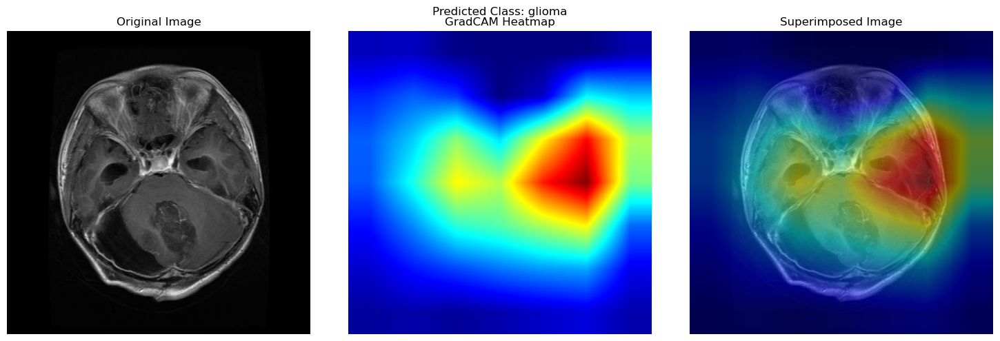


=== SHAP Visualization ===
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


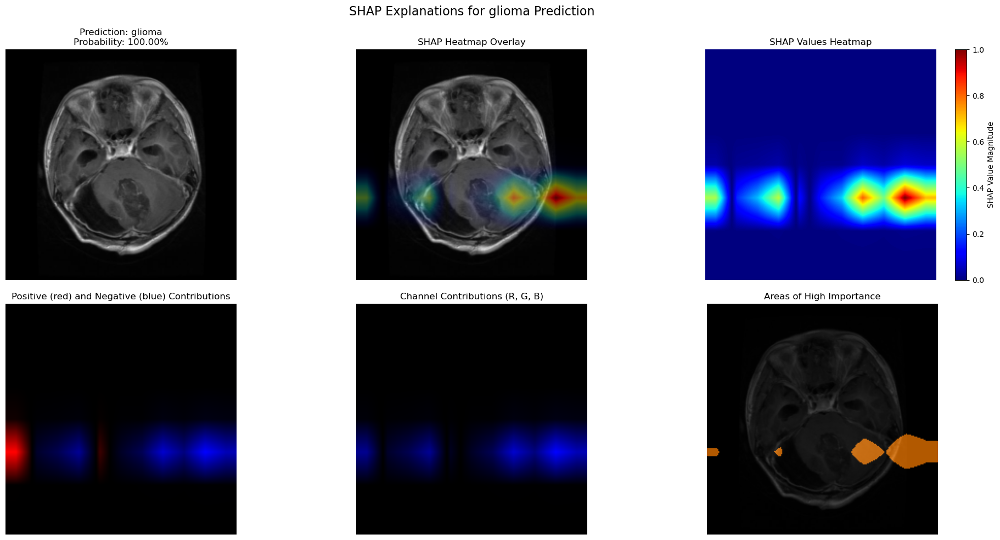

/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_7602/146183786.py:205: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<Figure size 1000x600 with 0 Axes>

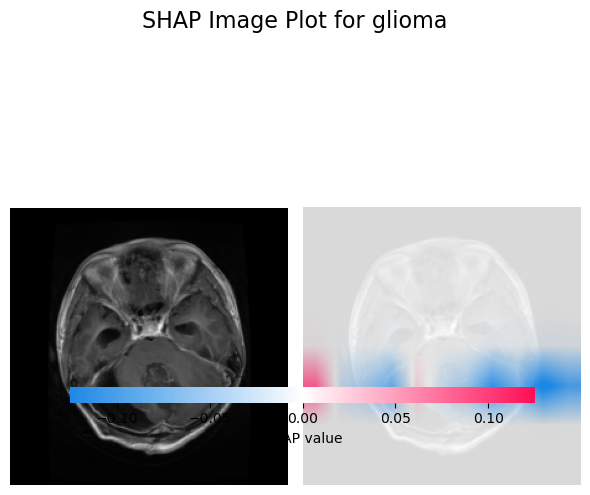

{'diagnosis': 'glioma',
 'confidence': 0.9999978542327881,
 'probabilities': {'pituitary': 1.968346907688101e-08,
  'healthy brain': 1.3645261276451492e-07,
  'glioma': 0.9999978542327881,
  'meningioma': 7.255266609718092e-07}}

In [56]:
image_pipeline(
    image_path = "/Users/academiccity/Documents/amokorankye/front end/server/test images/glioma.jpg", 
    diagnosisArea = "Brain Tumors", 
    model=comprehensive_model, 
    target_layer=comprehensive_model.layer4[-1],
    use_gradcam=True,
    use_shap=True
)

Model Evaluation

In [57]:
def evaluate_classification_model(model=comprehensive_model, test_dir=None, batch_size=32):
    """
    Evaluate the classification model using standard metrics:
    - Accuracy
    - Precision, Recall, F1-score
    - Confusion Matrix
    - ROC AUC (for multi-class, we'll use one-vs-rest)
    """
    from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve
    from torch.utils.data import DataLoader, Dataset
    import seaborn as sns
    from tqdm.notebook import tqdm
    
    class TestDataset(Dataset):
        """Custom dataset to load test images from directory"""
        def __init__(self, test_dir, transform=transform):
            self.test_dir = test_dir
            self.transform = transform
            self.image_paths = []
            self.labels = []
            
            # Example structure: test_dir/class_name/image.jpg
            for class_idx, class_name in enumerate(classes):
                class_dir = os.path.join(test_dir, class_name)
                if os.path.isdir(class_dir):
                    for img_name in os.listdir(class_dir):
                        if img_name.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tiff')):
                            self.image_paths.append(os.path.join(class_dir, img_name))
                            self.labels.append(class_idx)
            
        def __len__(self):
            return len(self.image_paths)
        
        def __getitem__(self, idx):
            image_path = self.image_paths[idx]
            label = self.labels[idx]
            
            # Load and transform image
            image = Image.open(image_path)
            if image.mode != 'RGB':
                image = image.convert('RGB')
            
            if self.transform:
                image = self.transform(image)
                
            return image, label
    
    # If no test directory is provided, show a message
    if test_dir is None:
        print("Please provide a test_dir path to evaluate the model on a test dataset.")
        print("Skipping evaluation metrics that require a test dataset.")
        return
    
    # Initialize test dataset and dataloader
    test_dataset = TestDataset(test_dir)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
    
    # Set model to evaluation mode
    model.eval()
    
    # Lists to store predictions and true labels
    all_preds = []
    all_labels = []
    all_probs = []
    
    # Perform inference
    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc="Evaluating model"):
            # Move data to the same device as model
            device = next(model.parameters()).device
            images = images.to(device)
            
            # Forward pass
            outputs = model(images)
            probs = torch.nn.functional.softmax(outputs, dim=1)
            preds = torch.argmax(outputs, dim=1)
            
            # Store results
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.numpy())
            all_probs.extend(probs.cpu().numpy())
    
    # Convert to numpy arrays for easier handling
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)
    all_probs = np.array(all_probs)
    
    # Calculate metrics
    accuracy = accuracy_score(all_labels, all_preds)
    
    # Print classification report
    print("\n=== Classification Report ===")
    print(classification_report(all_labels, all_preds, target_names=classes))
    
    # Calculate confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    # Plot confusion matrix
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
    plt.title("Confusion Matrix")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
    
    # Calculate ROC AUC (one vs rest for multi-class)
    try:
        # One-hot encode the labels for ROC AUC calculation
        roc_auc = roc_auc_score(
            np.eye(len(classes))[all_labels],  # Convert to one-hot encoding
            all_probs,
            multi_class='ovr'
        )
        print(f"\nROC AUC Score (One-vs-Rest): {roc_auc:.4f}")
        
        # Plot ROC curves for each class
        plt.figure(figsize=(12, 8))
        for i, class_name in enumerate(classes):
            y_true = (all_labels == i).astype(int)
            y_score = all_probs[:, i]
            
            fpr, tpr, _ = roc_curve(y_true, y_score)
            plt.plot(fpr, tpr, label=f"{class_name} (AUC: {roc_auc_score(y_true, y_score):.4f})")
        
        plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curves (One-vs-Rest)')
        plt.legend(loc="lower right")
        plt.show()
    except Exception as e:
        print(f"Error calculating ROC AUC: {e}")

    # Print summary metrics
    print("\n=== Summary Metrics ===")
    print(f"Accuracy: {accuracy:.4f}")
    
    return {
        "accuracy": accuracy,
        "predictions": all_preds,
        "true_labels": all_labels,
        "probabilities": all_probs
    }

GradCAM Evaluation

In [58]:
def evaluate_gradcam_quality(image_paths, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    """
    Evaluate GradCAM by comparing localization with random baseline
    and measuring IoU with ground truth masks if available
    """
    import time
    from skimage.metrics import structural_similarity as ssim
    
    # Check if we have a list of paths or a single path
    if isinstance(image_paths, str):
        image_paths = [image_paths]
        
    results = []
    
    for image_path in image_paths:
        print(f"Evaluating GradCAM for: {os.path.basename(image_path)}")
        
        # Measure execution time
        start_time = time.time()
        cam = apply_gradcam(image_path, model, target_layer)
        execution_time = time.time() - start_time
        
        if cam is None:
            print(f"GradCAM failed for {image_path}")
            continue
            
        # Generate a random baseline heatmap for comparison
        random_heatmap = np.random.random(cam.shape)
        
        # Load original image
        image = cv2.imread(image_path)
        if image is None:
            print(f"Could not load image from {image_path}")
            continue
            
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        # Resize cam to match image dimensions if needed
        if cam.shape != (image.shape[0], image.shape[1]):
            cam = cv2.resize(cam, (image.shape[1], image.shape[0]))
        
        # Measure energy concentration in heatmap
        # A good heatmap should have its energy concentrated in fewer pixels
        cam_sorted = np.sort(cam.flatten())[::-1]  # Sort in descending order
        energy_concentration = np.sum(cam_sorted[:int(0.2*len(cam_sorted))]) / np.sum(cam_sorted)
        
        # Heatmap entropy - lower entropy means more focused attention
        eps = 1e-10  # Small constant to avoid log(0)
        normalized_cam = cam / (np.sum(cam) + eps)
        entropy = -np.sum(normalized_cam * np.log(normalized_cam + eps))
        
        # Generate binary mask from heatmap using Otsu's method
        cam_uint8 = (cam * 255).astype(np.uint8)
        _, binary_mask = cv2.threshold(cam_uint8, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
        # Check if a ground truth segmentation mask is available
        mask_path = image_path.replace('.jpg', '_mask.png').replace('.jpeg', '_mask.png').replace('.png', '_mask.png')
        has_gt_mask = os.path.exists(mask_path)
        iou_score = None
        
        if has_gt_mask:
            # Load and preprocess ground truth mask
            gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            gt_mask = cv2.resize(gt_mask, (binary_mask.shape[1], binary_mask.shape[0]))
            gt_mask = (gt_mask > 0).astype(np.uint8)
            
            # Calculate IoU (Intersection over Union)
            intersection = np.logical_and(binary_mask, gt_mask).sum()
            union = np.logical_or(binary_mask, gt_mask).sum()
            iou_score = intersection / (union + eps)
            
            print(f"IoU with ground truth: {iou_score:.4f}")
        
        # Compare with random baseline using structural similarity
        ssim_random = ssim(cam, random_heatmap, data_range=1.0)
        
        # Store results
        result = {
            "image_path": image_path,
            "execution_time": execution_time,
            "energy_concentration": energy_concentration,
            "entropy": entropy,
            "ssim_random": ssim_random,
            "has_gt_mask": has_gt_mask,
            "iou_score": iou_score
        }
        results.append(result)
        
        # Print results
        print(f"Execution time: {execution_time:.4f} seconds")
        print(f"Energy concentration: {energy_concentration:.4f}")
        print(f"Entropy: {entropy:.4f}")
        print(f"SSIM with random baseline: {ssim_random:.4f}")
        print("-" * 40)
    
    # Calculate average metrics
    if results:
        avg_execution_time = np.mean([r["execution_time"] for r in results])
        avg_energy = np.mean([r["energy_concentration"] for r in results])
        avg_entropy = np.mean([r["entropy"] for r in results])
        avg_ssim = np.mean([r["ssim_random"] for r in results])
        
        # Calculate average IoU if ground truth masks are available
        iou_scores = [r["iou_score"] for r in results if r["iou_score"] is not None]
        avg_iou = np.mean(iou_scores) if iou_scores else None
        
        print("\n=== GradCAM Evaluation Summary ===")
        print(f"Average execution time: {avg_execution_time:.4f} seconds")
        print(f"Average energy concentration: {avg_energy:.4f} (higher is better)")
        print(f"Average entropy: {avg_entropy:.4f} (lower is better)")
        print(f"Average SSIM with random baseline: {avg_ssim:.4f} (lower is better)")
        if avg_iou is not None:
            print(f"Average IoU with ground truth: {avg_iou:.4f} (higher is better)")
    
    return results

SHAP Evaluation

In [59]:
def evaluate_shap_quality(image_paths, model=comprehensive_model, n_samples=100):
    """
    Evaluate SHAP explanations quality using various metrics
    """
    import time
    from skimage.metrics import structural_similarity as ssim
    
    # Check if we have a list of paths or a single path
    if isinstance(image_paths, str):
        image_paths = [image_paths]
    
    results = []
    
    for image_path in image_paths:
        print(f"Evaluating SHAP for: {os.path.basename(image_path)}")
        
        # Determine diagnosis area from the image path or filename
        # This is a simplification - adjust based on your actual organization
        filename = os.path.basename(image_path).lower()
        if any(x in filename for x in ['glioma', 'meningioma', 'pituitary']):
            diagnosisArea = "Brain Tumors"
        elif any(x in filename for x in ['breast']):
            diagnosisArea = "Breast Cancer"
        elif any(x in filename for x in ['bone', 'fracture']):
            diagnosisArea = "Bone Fractures"
        elif any(x in filename for x in ['adenocarcinoma', 'squamous']):
            diagnosisArea = "Lung Cancer"
        else:
            diagnosisArea = None
            
        # Get prediction for the image
        pred_result = predict(image_path, diagnosisArea)
        if not pred_result:
            print(f"Prediction failed for {image_path}")
            continue
            
        # Get target class from prediction
        target_class = classes.index(pred_result['diagnosis']) if pred_result['diagnosis'] in classes else None
        
        # Measure execution time
        start_time = time.time()
        shap_values, img_display = apply_shap(image_path, model, target_class, n_samples=n_samples)
        execution_time = time.time() - start_time
        
        if shap_values is None:
            print(f"SHAP analysis failed for {image_path}")
            continue
        
        # Aggregate SHAP values across channels
        shap_magnitude = np.sum(np.abs(shap_values), axis=0)
        
        # Normalize for easier analysis
        shap_norm = shap_magnitude / np.max(shap_magnitude)
        
        # Generate a random baseline for comparison
        random_shap = np.random.random(shap_norm.shape)
        
        # Compute metrics
        
        # 1. Energy concentration (how focused the explanation is)
        shap_sorted = np.sort(shap_norm.flatten())[::-1]  # Sort in descending order
        energy_concentration = np.sum(shap_sorted[:int(0.2*len(shap_sorted))]) / np.sum(shap_sorted)
        
        # 2. Entropy (lower is better, more focused)
        eps = 1e-10  # Small constant to avoid log(0)
        normalized_shap = shap_norm / (np.sum(shap_norm) + eps)
        entropy = -np.sum(normalized_shap * np.log(normalized_shap + eps))
        
        # 3. SSIM with random baseline (lower is better)
        ssim_random = ssim(shap_norm, random_shap, data_range=1.0)
        
        # 4. Sparsity (percentage of values near zero)
        sparsity = np.mean(shap_norm < 0.1)
        
        # Check if we have a ground truth segmentation mask available
        mask_path = image_path.replace('.jpg', '_mask.png').replace('.jpeg', '_mask.png').replace('.png', '_mask.png')
        has_gt_mask = os.path.exists(mask_path)
        iou_score = None
        
        if has_gt_mask:
            # Create binary mask from SHAP values using Otsu's method
            shap_uint8 = (shap_norm * 255).astype(np.uint8)
            _, shap_binary = cv2.threshold(shap_uint8, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
            
            # Load and preprocess ground truth mask
            gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            gt_mask = cv2.resize(gt_mask, (shap_binary.shape[1], shap_binary.shape[0]))
            gt_mask = (gt_mask > 0).astype(np.uint8)
            
            # Calculate IoU (Intersection over Union)
            intersection = np.logical_and(shap_binary, gt_mask).sum()
            union = np.logical_or(shap_binary, gt_mask).sum()
            iou_score = intersection / (union + eps)
            
            print(f"IoU with ground truth: {iou_score:.4f}")
        
        # Store results
        result = {
            "image_path": image_path,
            "execution_time": execution_time,
            "energy_concentration": energy_concentration,
            "entropy": entropy,
            "ssim_random": ssim_random,
            "sparsity": sparsity,
            "has_gt_mask": has_gt_mask,
            "iou_score": iou_score
        }
        results.append(result)
        
        # Print results
        print(f"Execution time: {execution_time:.4f} seconds")
        print(f"Energy concentration: {energy_concentration:.4f}")
        print(f"Entropy: {entropy:.4f}")
        print(f"SSIM with random baseline: {ssim_random:.4f}")
        print(f"Sparsity: {sparsity:.4f}")
        print("-" * 40)
    
    # Calculate average metrics
    if results:
        avg_execution_time = np.mean([r["execution_time"] for r in results])
        avg_energy = np.mean([r["energy_concentration"] for r in results])
        avg_entropy = np.mean([r["entropy"] for r in results])
        avg_ssim = np.mean([r["ssim_random"] for r in results])
        avg_sparsity = np.mean([r["sparsity"] for r in results])
        
        # Calculate average IoU if ground truth masks are available
        iou_scores = [r["iou_score"] for r in results if r["iou_score"] is not None]
        avg_iou = np.mean(iou_scores) if iou_scores else None
        
        print("\n=== SHAP Evaluation Summary ===")
        print(f"Average execution time: {avg_execution_time:.4f} seconds")
        print(f"Average energy concentration: {avg_energy:.4f} (higher is better)")
        print(f"Average entropy: {avg_entropy:.4f} (lower is better)")
        print(f"Average SSIM with random baseline: {avg_ssim:.4f} (lower is better)")
        print(f"Average sparsity: {avg_sparsity:.4f} (context dependent)")
        if avg_iou is not None:
            print(f"Average IoU with ground truth: {avg_iou:.4f} (higher is better)")
    
    return results

SHAP and GradCAM Evaluation

In [60]:
def compare_explainability_methods(image_path, diagnosisArea, model=comprehensive_model, target_layer=comprehensive_model.layer4[-1]):
    """
    Compare GradCAM and SHAP explanations for the same image and prediction
    """
    # Get prediction
    prediction_result = predict(image_path, diagnosisArea)
    if not prediction_result:
        print("Prediction failed")
        return None
    
    # Get the index of the predicted class
    class_name = prediction_result['diagnosis']
    target_class = classes.index(class_name) if class_name in classes else None
    
    print(f"\n=== Comparing Explainability Methods for {os.path.basename(image_path)} ===")
    print(f"Predicted class: {class_name} (confidence: {prediction_result['confidence']:.2%})")
    
    # Generate GradCAM
    print("\nGenerating GradCAM...")
    gradcam_start = time.time()
    cam = apply_gradcam(image_path, model, target_layer)
    gradcam_time = time.time() - gradcam_start
    print(f"GradCAM generation time: {gradcam_time:.4f} seconds")
    
    # Generate SHAP
    print("\nGenerating SHAP explanation...")
    shap_start = time.time()
    shap_values, img_display = apply_shap(image_path, model, target_class)
    shap_time = time.time() - shap_start
    print(f"SHAP generation time: {shap_time:.4f} seconds")
    
    if cam is None or shap_values is None:
        print("One or both explainability methods failed")
        return None
    
    # Process explanations for comparison
    # Resize GradCAM to match SHAP dimensions if needed
    if cam.shape != (224, 224):
        cam = cv2.resize(cam, (224, 224))
    
    # Get SHAP magnitude
    shap_magnitude = np.sum(np.abs(shap_values), axis=0)
    
    # Normalize both for fair comparison
    cam_norm = cam / np.max(cam)
    shap_norm = shap_magnitude / np.max(shap_magnitude)
    
    # Compute similarity between the two explanations
    correlation = np.corrcoef(cam_norm.flatten(), shap_norm.flatten())[0, 1]
    ssim_value = ssim(cam_norm, shap_norm, data_range=1.0)
    
    # Compare focus areas
    # Get top 20% of highlighted areas in each method
    cam_top = cam_norm > np.percentile(cam_norm, 80)
    shap_top = shap_norm > np.percentile(shap_norm, 80)
    
    # IoU between top regions
    intersection = np.logical_and(cam_top, shap_top).sum()
    union = np.logical_or(cam_top, shap_top).sum()
    iou = intersection / union if union > 0 else 0
    
    # Visual comparison
    plt.figure(figsize=(15, 10))
    
    # Original image
    plt.subplot(2, 3, 1)
    plt.imshow(img_display)
    plt.title("Original Image")
    plt.axis('off')
    
    # GradCAM heatmap
    plt.subplot(2, 3, 2)
    plt.imshow(cam_norm, cmap='jet')
    plt.title("GradCAM Heatmap")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # SHAP heatmap
    plt.subplot(2, 3, 3)
    plt.imshow(shap_norm, cmap='jet')
    plt.title("SHAP Heatmap")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # Difference map
    plt.subplot(2, 3, 4)
    diff_map = cam_norm - shap_norm
    plt.imshow(diff_map, cmap='coolwarm', vmin=-1, vmax=1)
    plt.title("Difference (GradCAM - SHAP)")
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.axis('off')
    
    # Top regions GradCAM
    plt.subplot(2, 3, 5)
    plt.imshow(img_display)
    plt.imshow(np.ma.masked_where(~cam_top, np.ones_like(cam_top)), 
               cmap='autumn', alpha=0.7)
    plt.title("GradCAM Top 20% Regions")
    plt.axis('off')
    
    # Top regions SHAP
    plt.subplot(2, 3, 6)
    plt.imshow(img_display)
    plt.imshow(np.ma.masked_where(~shap_top, np.ones_like(shap_top)), 
               cmap='winter', alpha=0.7)
    plt.title("SHAP Top 20% Regions")
    plt.axis('off')
    
    plt.suptitle(
        f"Comparison of GradCAM and SHAP Explanations\n"
        f"Correlation: {correlation:.4f}, SSIM: {ssim_value:.4f}, IoU of Top Regions: {iou:.4f}",
        fontsize=16
    )
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()
    
    # Print comparison metrics
    print("\n=== Explainability Methods Comparison ===")
    print(f"Correlation between heatmaps: {correlation:.4f}")
    print(f"SSIM between heatmaps: {ssim_value:.4f}")
    print(f"IoU of top 20% regions: {iou:.4f}")
    print(f"GradCAM execution time: {gradcam_time:.4f} seconds")
    print(f"SHAP execution time: {shap_time:.4f} seconds")
    
    return {
        "correlation": correlation,
        "ssim": ssim_value,
        "iou": iou,
        "gradcam_time": gradcam_time,
        "shap_time": shap_time
    }

Evaluation Loop

Evaluating images:   0%|          | 0/10 [00:00<?, ?it/s]


Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%


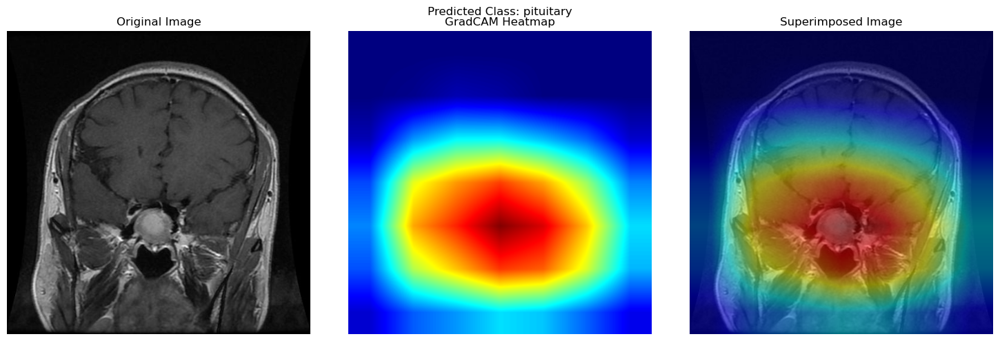

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


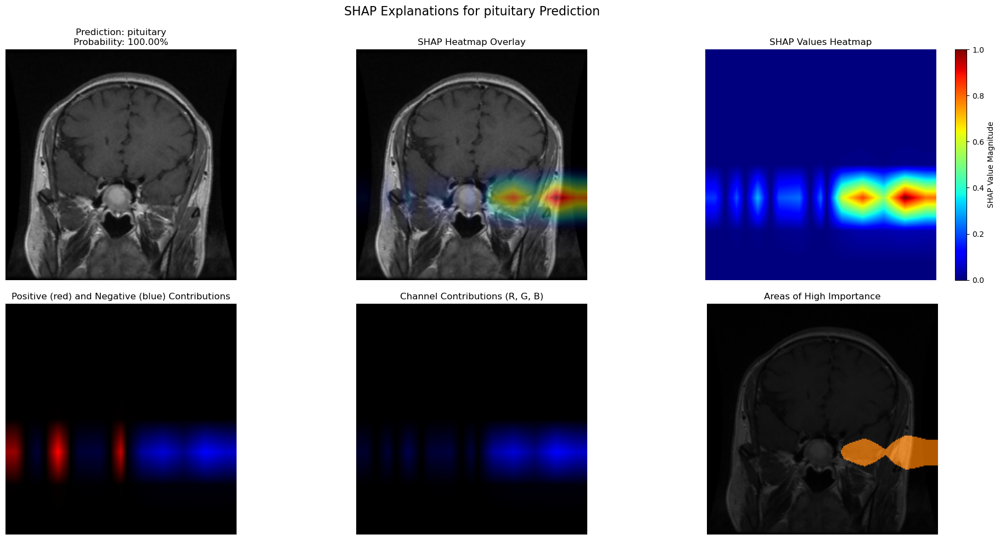

/var/folders/2z/km3f0zgd0hzf9zk_ctnxyzzw0000gn/T/ipykernel_7602/146183786.py:205: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


<Figure size 1000x600 with 0 Axes>

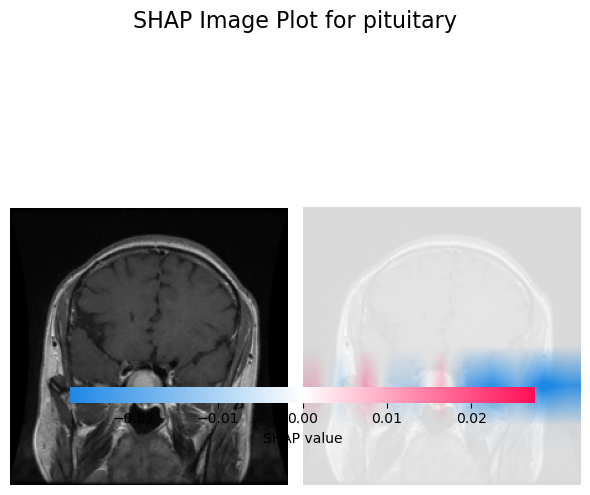


Diagnosis Results:
Classification: pituitary
Confidence: 100.00%

Class Probabilities:
pituitary: 100.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 0.00%

=== Comparing Explainability Methods for pituitary.jpg ===
Predicted class: pituitary (confidence: 100.00%)

Generating GradCAM...


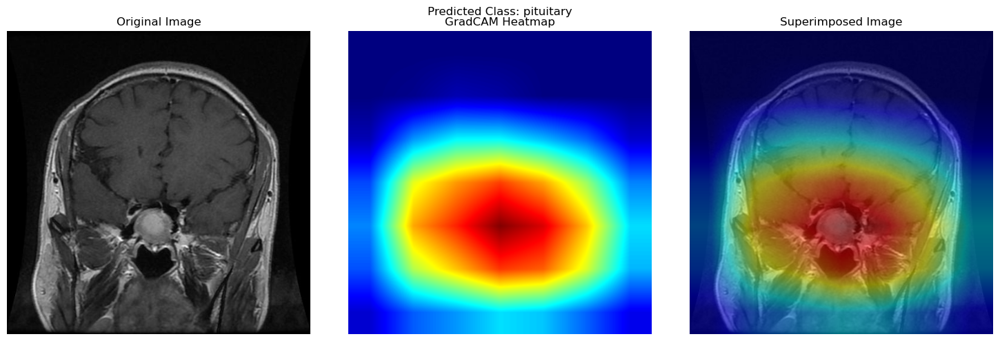

GradCAM generation time: 0.2051 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


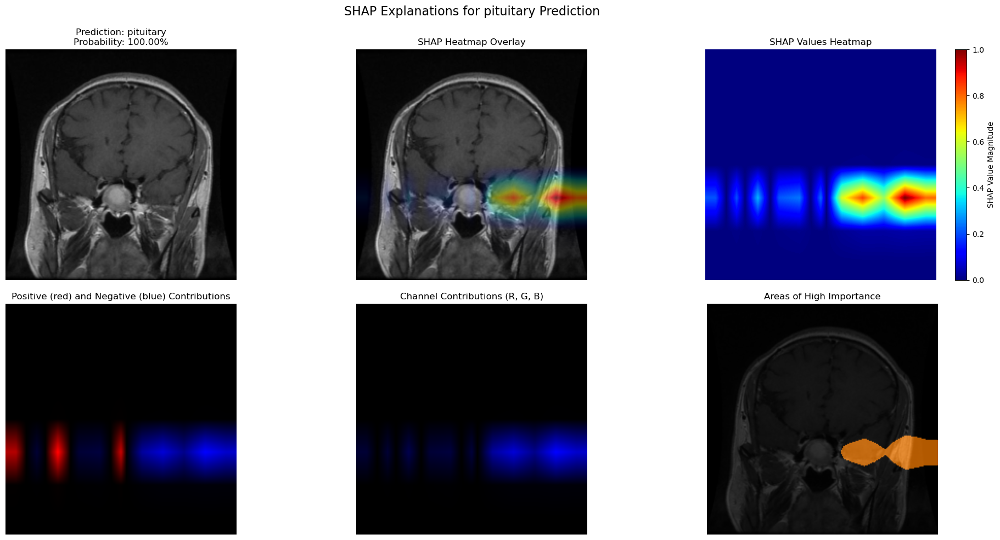

<Figure size 1000x600 with 0 Axes>

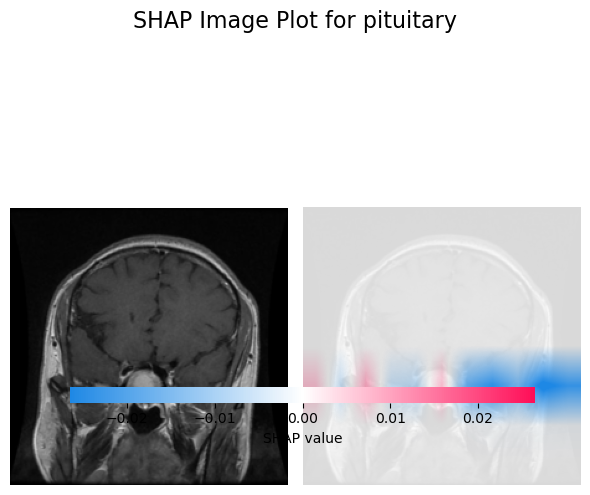

SHAP generation time: 64.2446 seconds


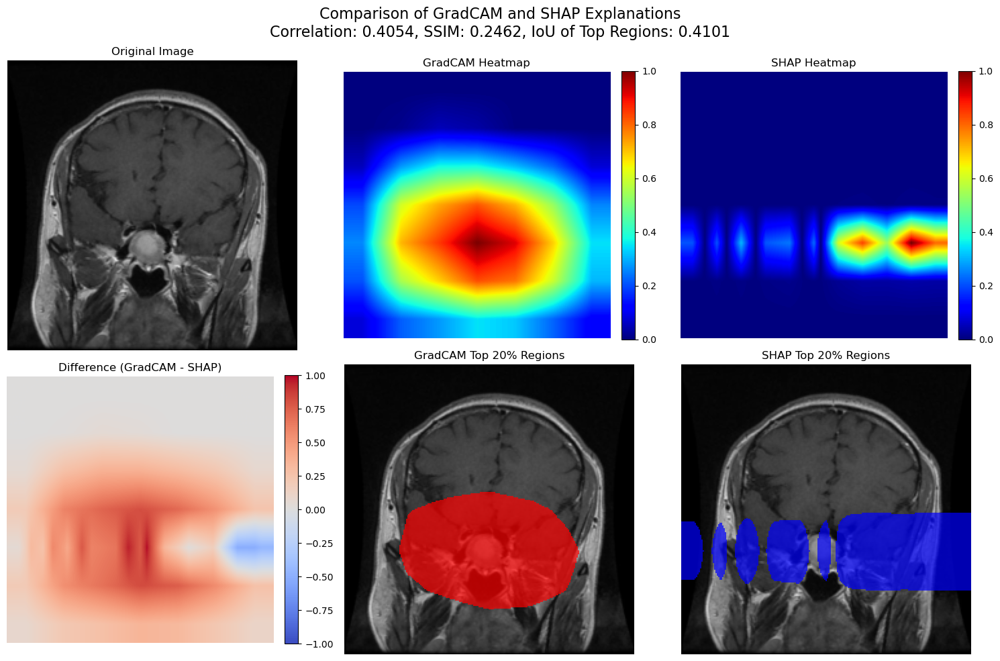


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4054
SSIM between heatmaps: 0.2462
IoU of top 20% regions: 0.4101
GradCAM execution time: 0.2051 seconds
SHAP execution time: 64.2446 seconds

Diagnosis Results:
Classification: bone fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 100.00%
bone not fractured: 0.00%


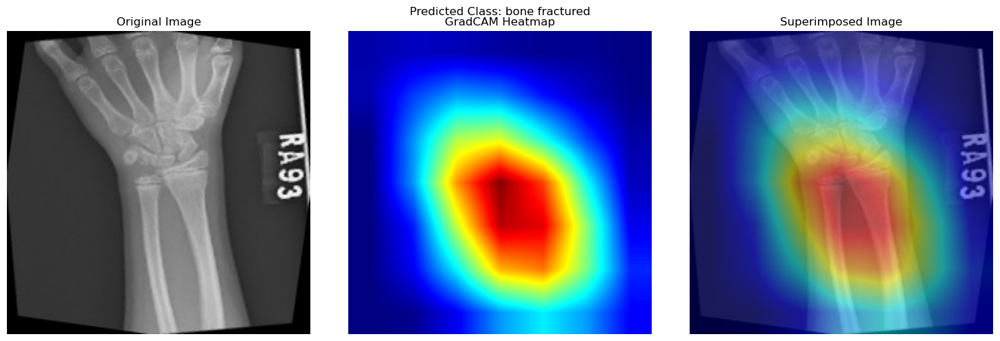

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


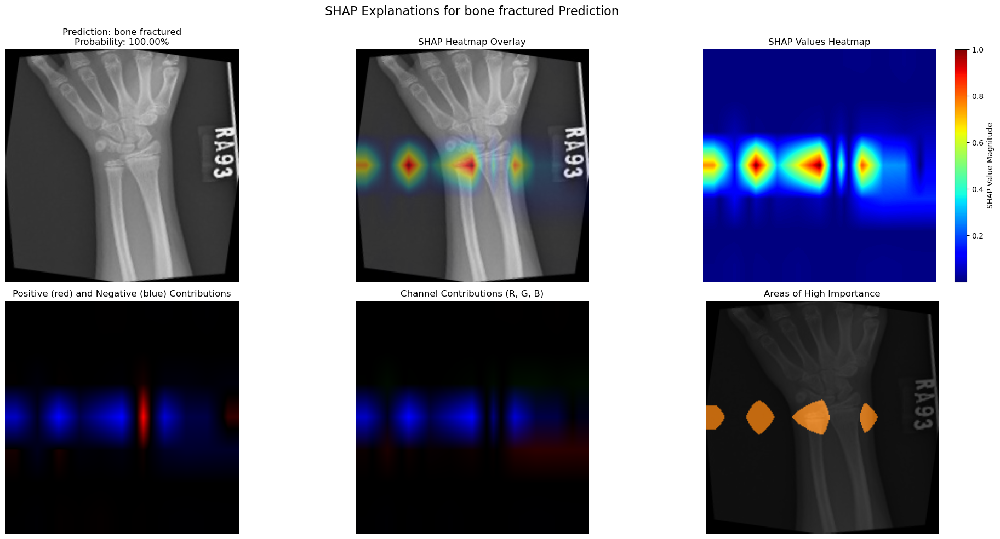

<Figure size 1000x600 with 0 Axes>

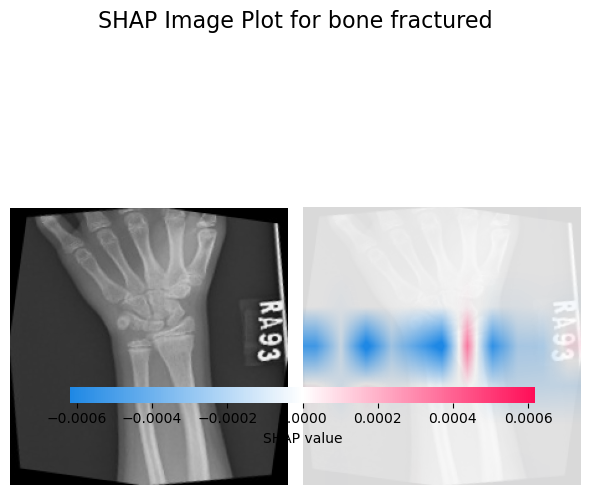


Diagnosis Results:
Classification: bone fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 100.00%
bone not fractured: 0.00%

=== Comparing Explainability Methods for bone fractured.jpg ===
Predicted class: bone fractured (confidence: 100.00%)

Generating GradCAM...


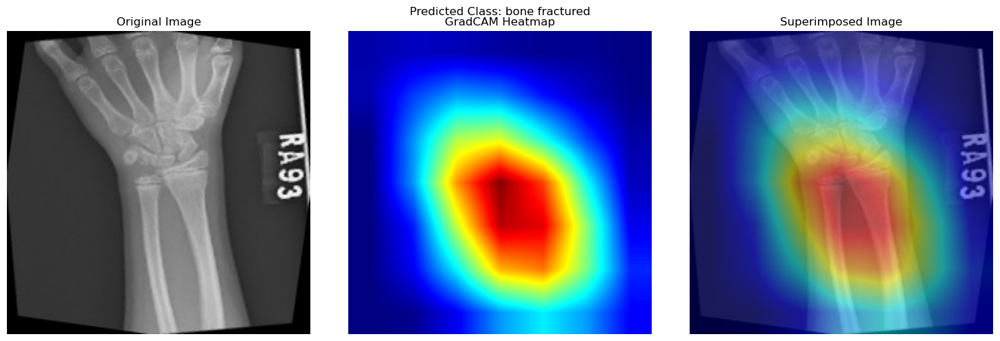

GradCAM generation time: 0.1838 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


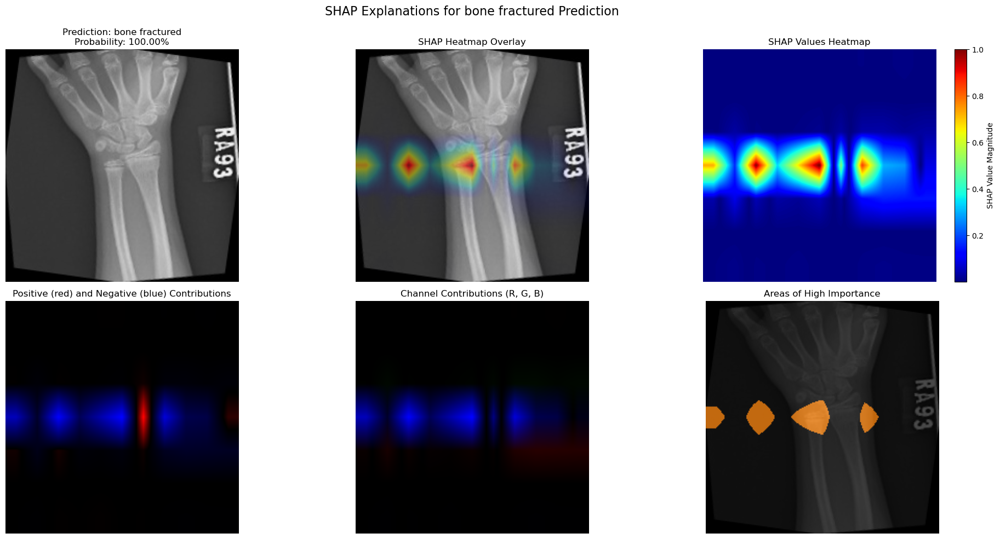

<Figure size 1000x600 with 0 Axes>

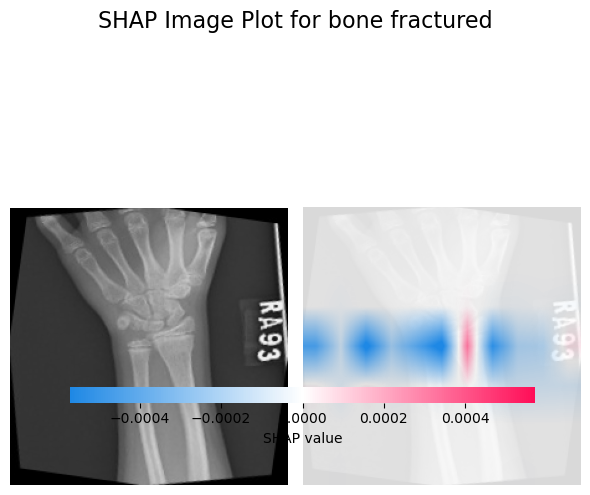

SHAP generation time: 63.1795 seconds


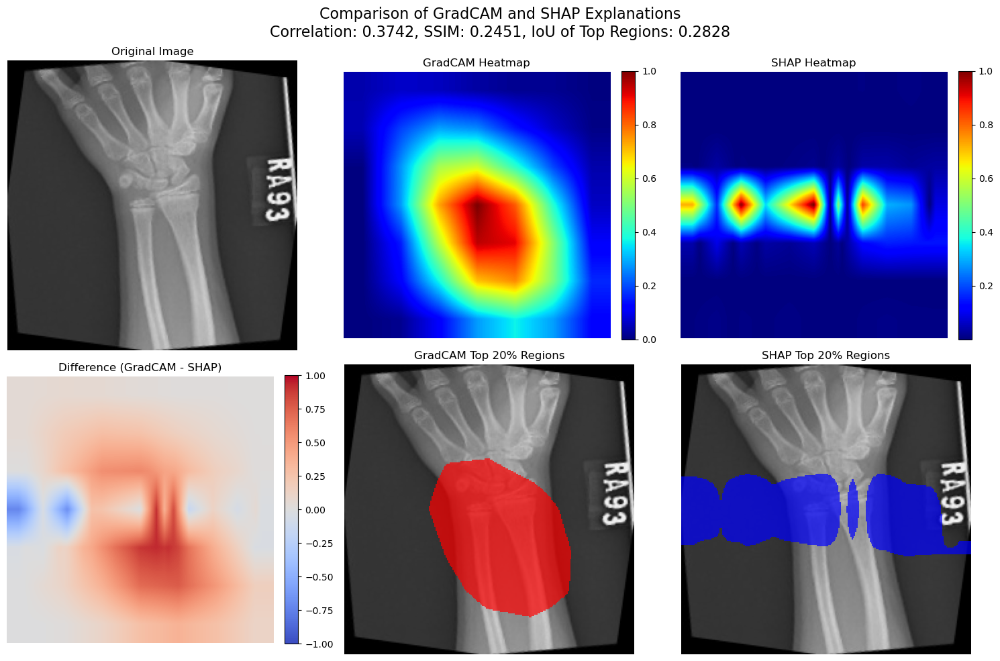


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.3742
SSIM between heatmaps: 0.2451
IoU of top 20% regions: 0.2828
GradCAM execution time: 0.1838 seconds
SHAP execution time: 63.1795 seconds

Diagnosis Results:
Classification: healthy brain
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 100.00%
glioma: 0.00%
meningioma: 0.00%


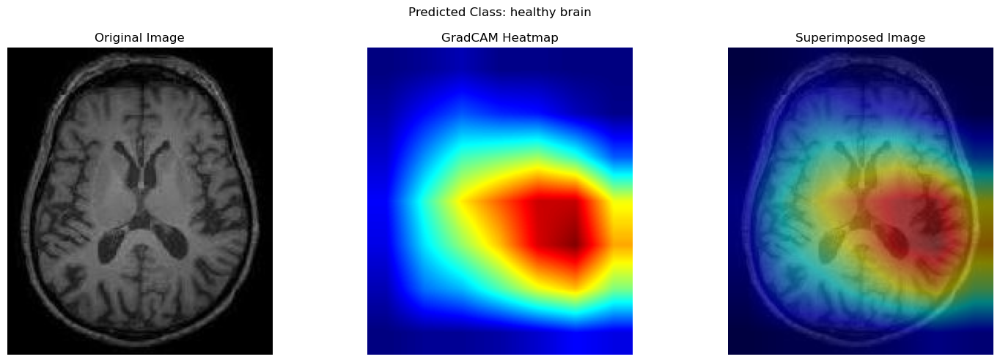

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


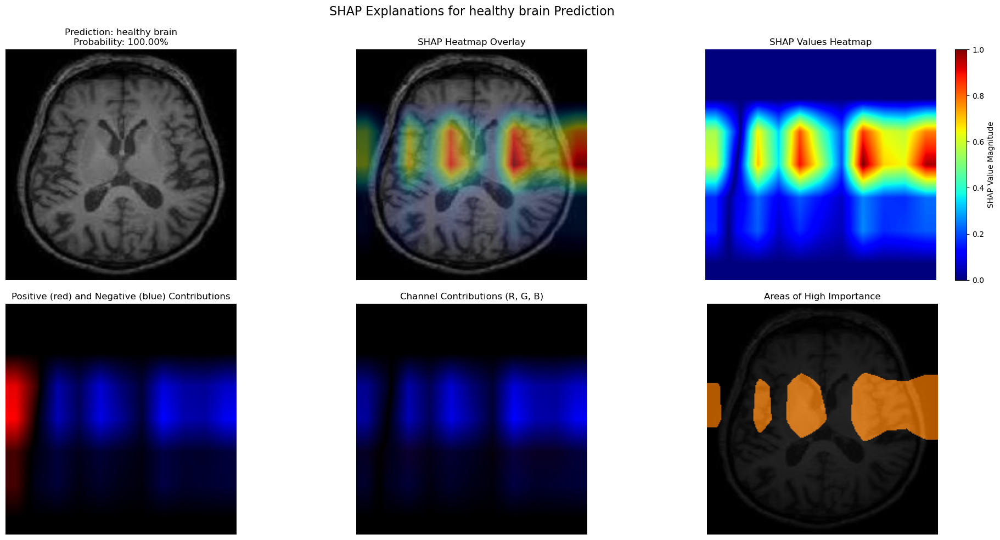

<Figure size 1000x600 with 0 Axes>

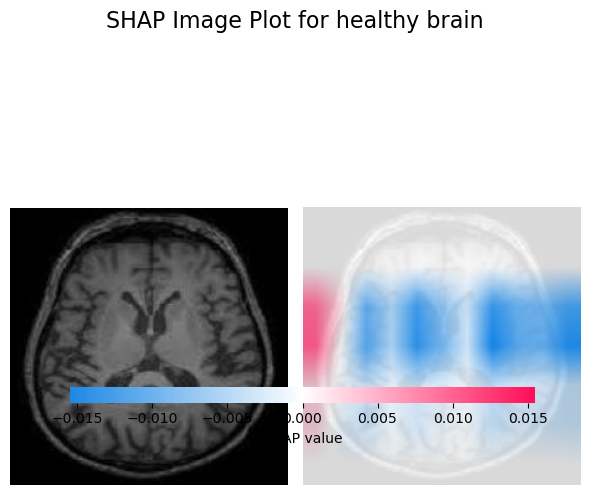


Diagnosis Results:
Classification: healthy brain
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 100.00%
glioma: 0.00%
meningioma: 0.00%

=== Comparing Explainability Methods for healthy brain.jpg ===
Predicted class: healthy brain (confidence: 100.00%)

Generating GradCAM...


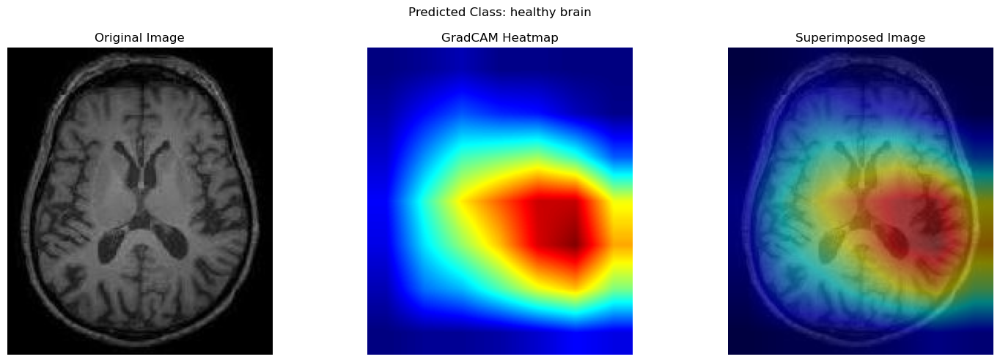

GradCAM generation time: 0.1812 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


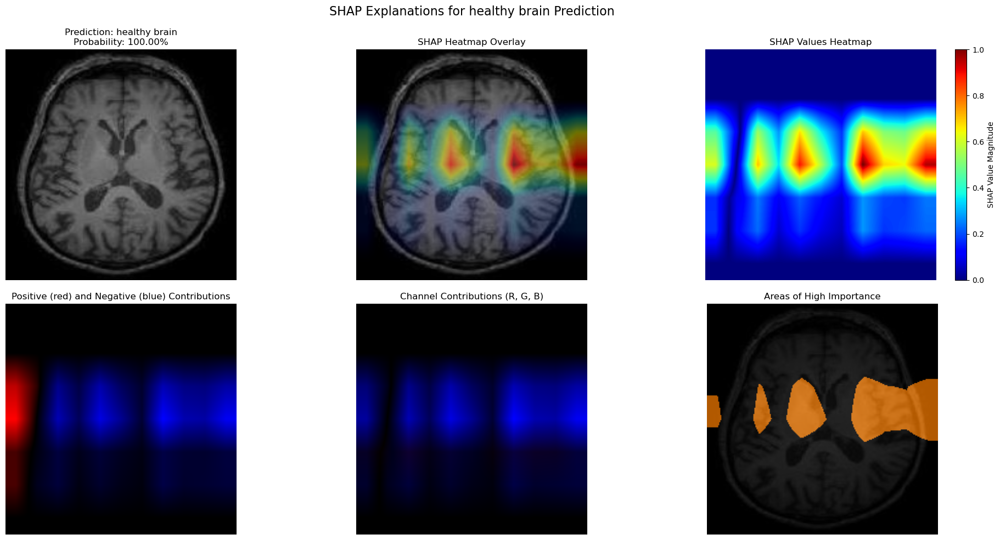

<Figure size 1000x600 with 0 Axes>

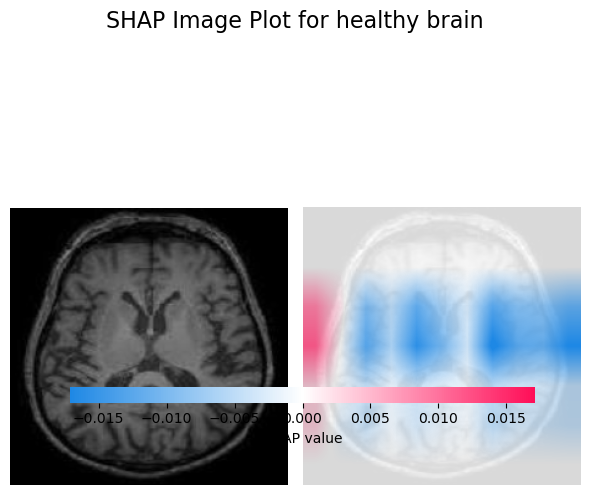

SHAP generation time: 64.3472 seconds


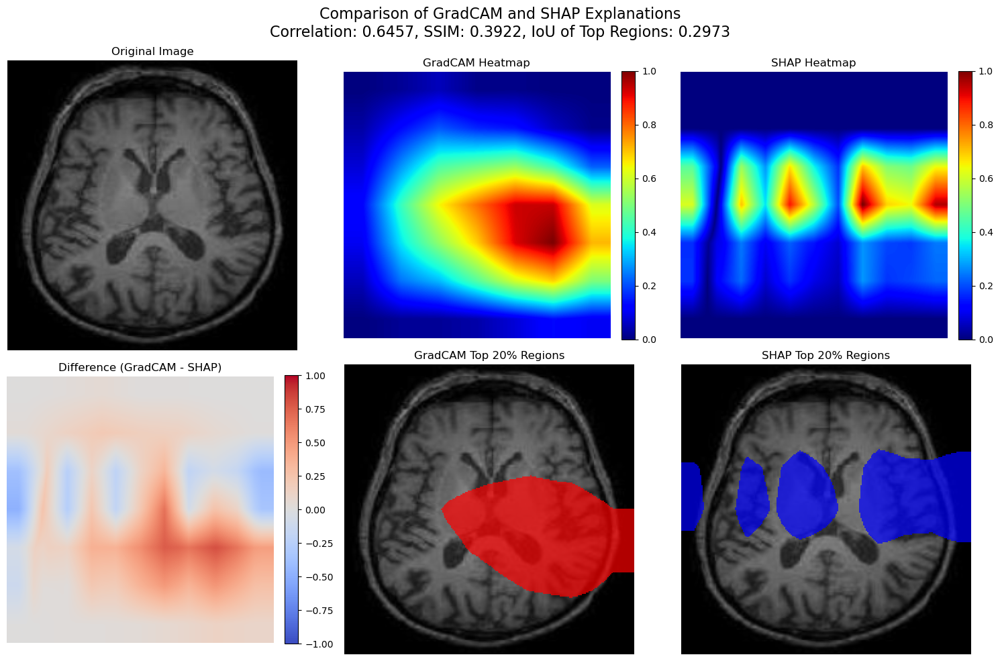


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.6457
SSIM between heatmaps: 0.3922
IoU of top 20% regions: 0.2973
GradCAM execution time: 0.1812 seconds
SHAP execution time: 64.3472 seconds

Diagnosis Results:
Classification: adenocarcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 100.00%
benign: 0.00%
squamous cell carcinoma: 0.00%


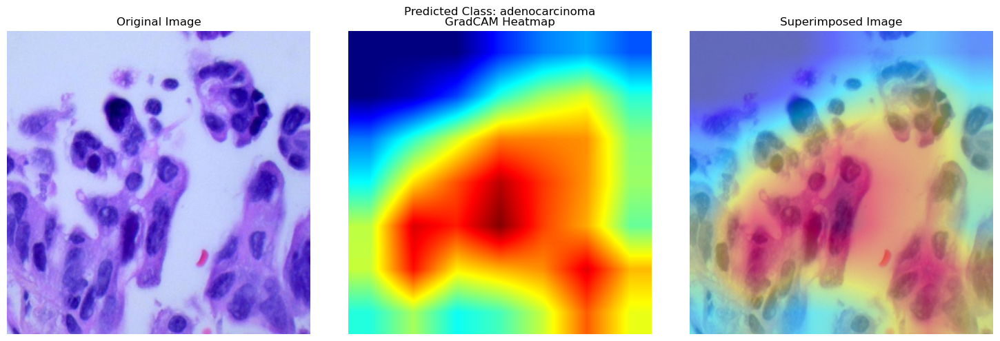

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


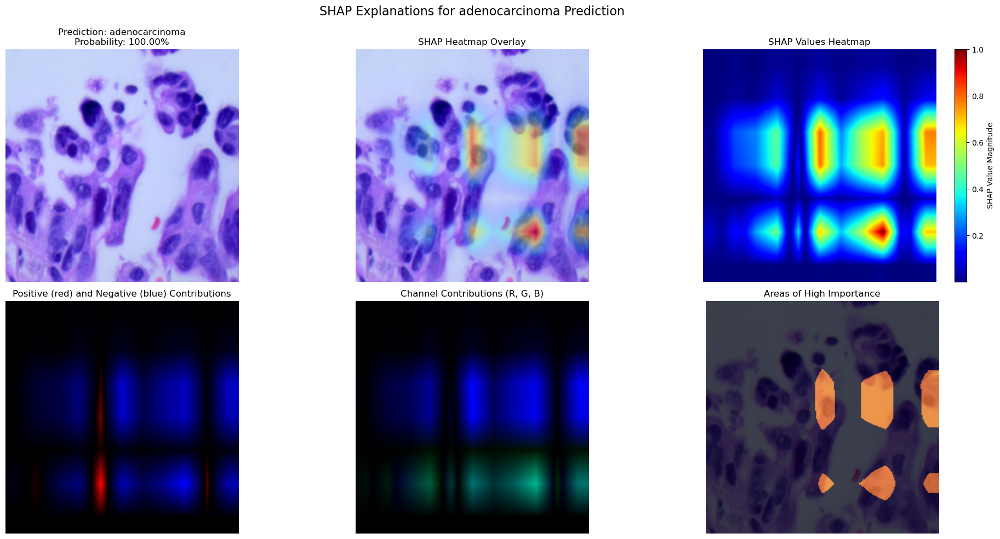

<Figure size 1000x600 with 0 Axes>

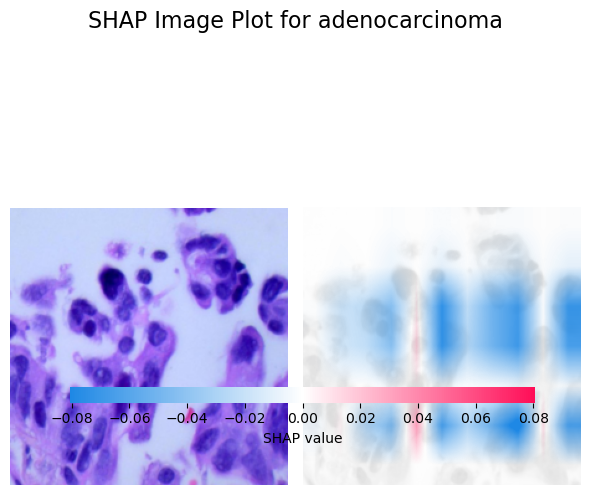


Diagnosis Results:
Classification: adenocarcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 100.00%
benign: 0.00%
squamous cell carcinoma: 0.00%

=== Comparing Explainability Methods for adenocarcinoma.jpg ===
Predicted class: adenocarcinoma (confidence: 100.00%)

Generating GradCAM...


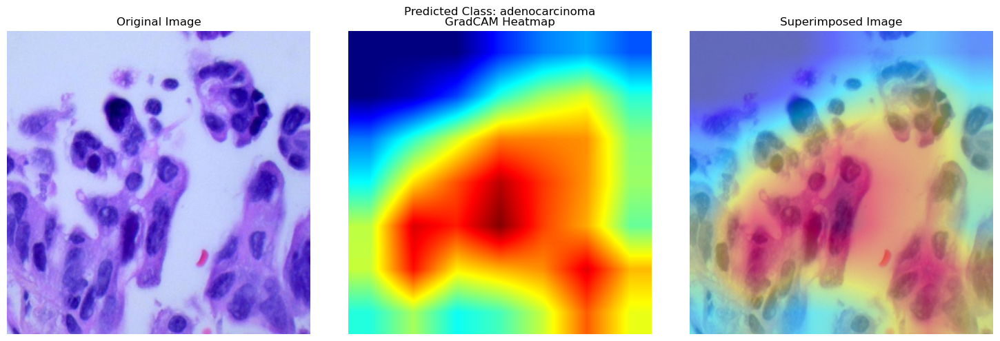

GradCAM generation time: 0.2905 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


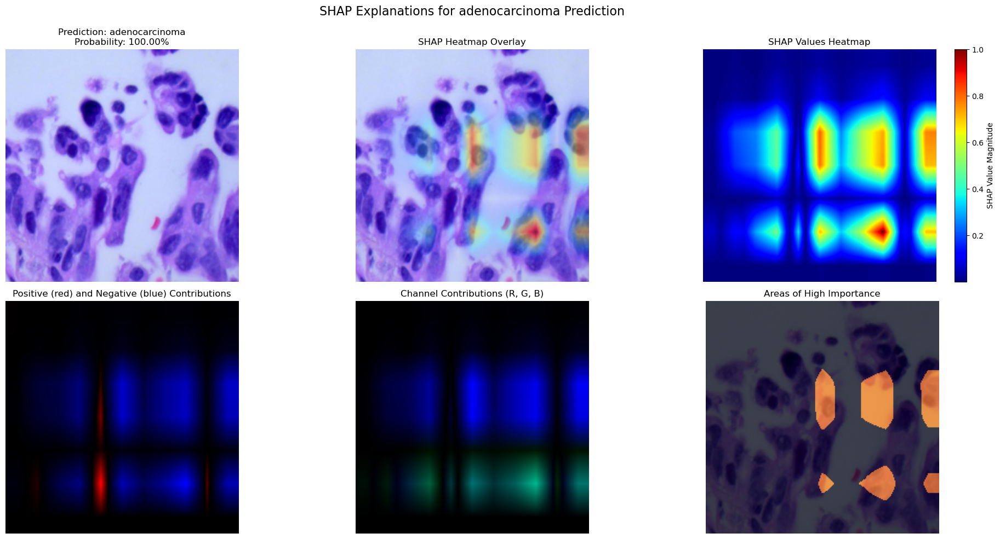

<Figure size 1000x600 with 0 Axes>

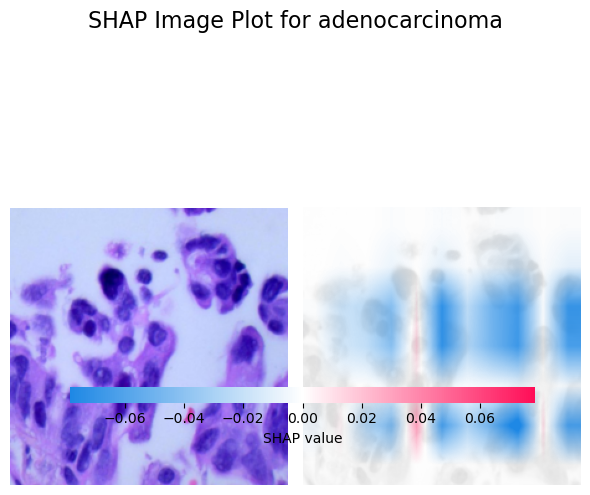

SHAP generation time: 64.6241 seconds


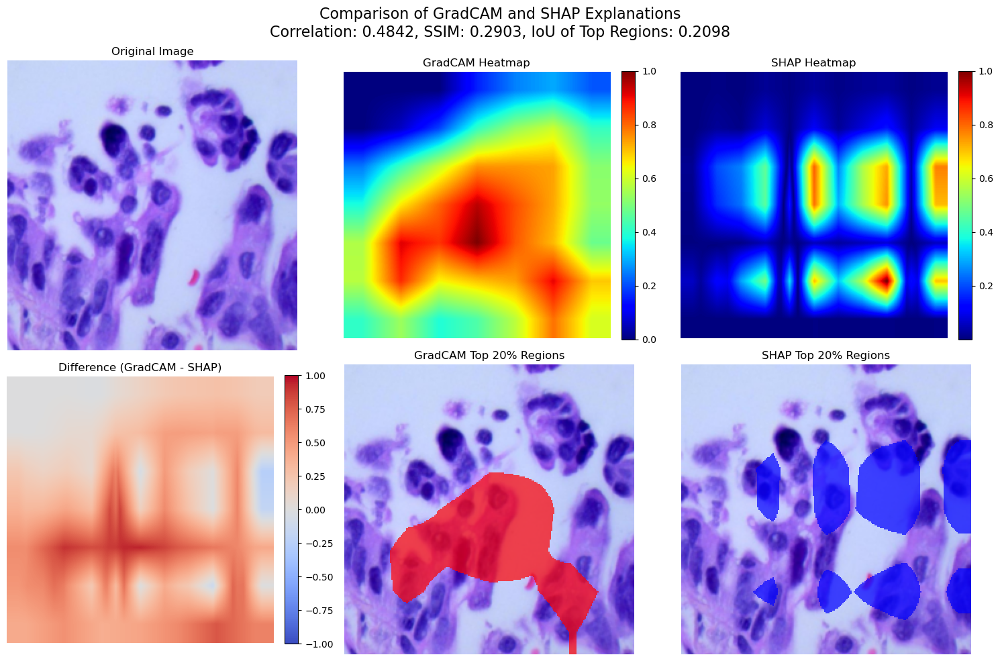


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4842
SSIM between heatmaps: 0.2903
IoU of top 20% regions: 0.2098
GradCAM execution time: 0.2905 seconds
SHAP execution time: 64.6241 seconds

Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%


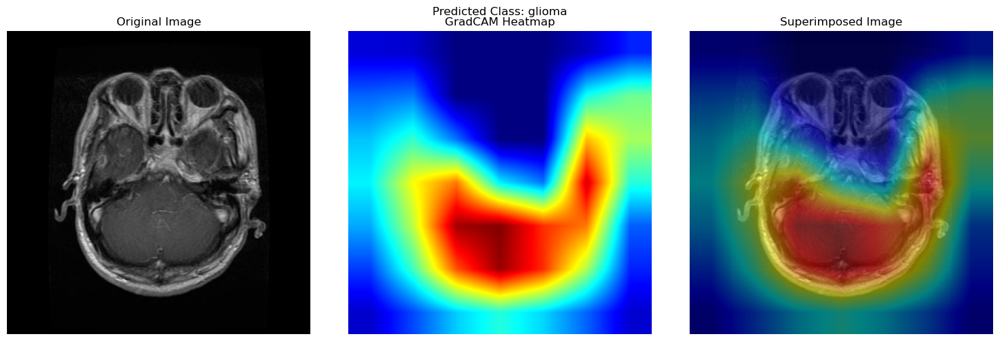

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


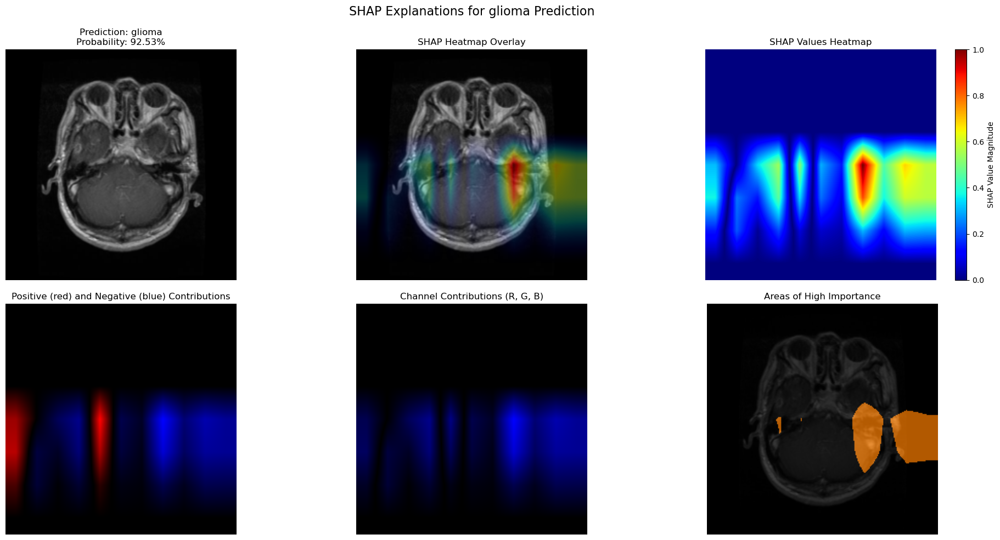

<Figure size 1000x600 with 0 Axes>

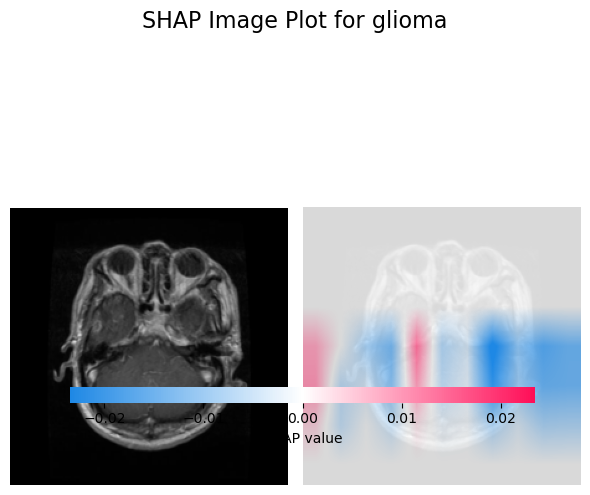


Diagnosis Results:
Classification: glioma
Confidence: 92.53%

Class Probabilities:
pituitary: 7.38%
healthy brain: 0.00%
glioma: 92.53%
meningioma: 0.09%

=== Comparing Explainability Methods for glioma.jpg ===
Predicted class: glioma (confidence: 92.53%)

Generating GradCAM...


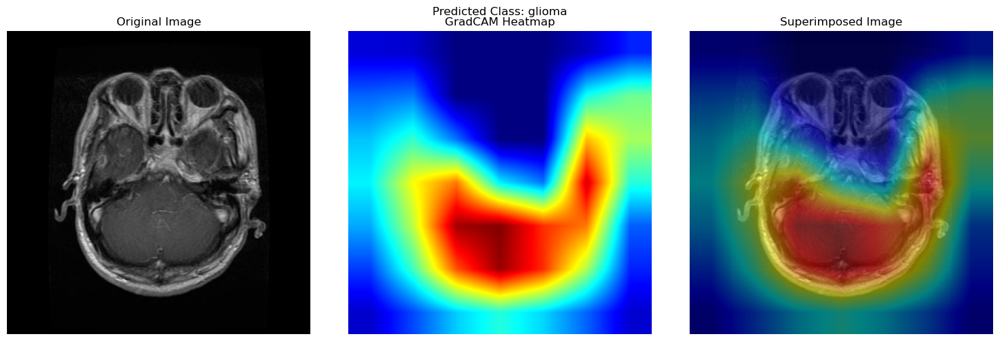

GradCAM generation time: 0.1889 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


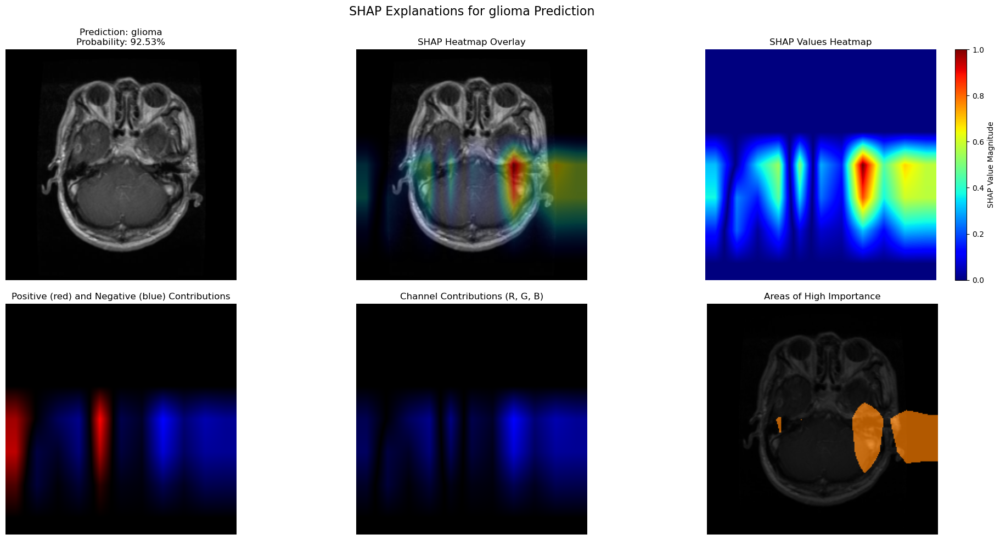

<Figure size 1000x600 with 0 Axes>

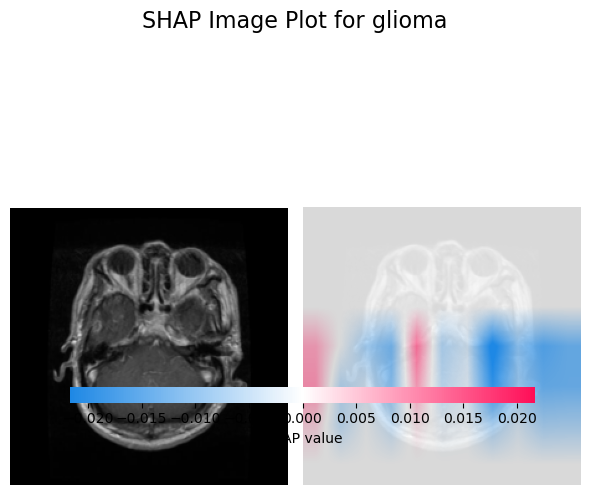

SHAP generation time: 63.7636 seconds


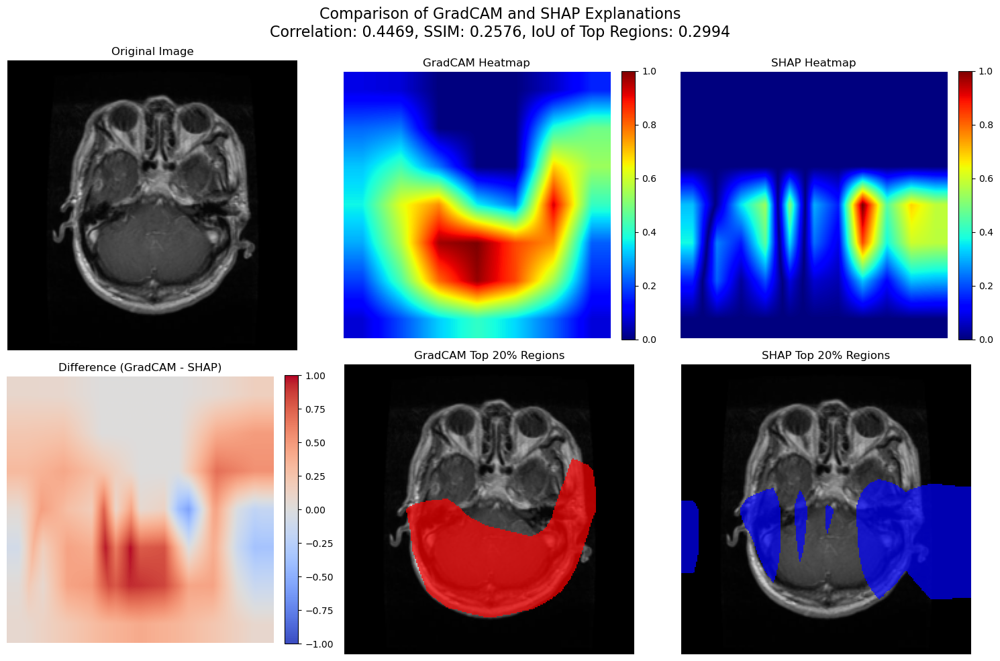


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.4469
SSIM between heatmaps: 0.2576
IoU of top 20% regions: 0.2994
GradCAM execution time: 0.1889 seconds
SHAP execution time: 63.7636 seconds

Diagnosis Results:
Classification: breast cancer positive
Confidence: 98.17%

Class Probabilities:
breast cancer negative: 1.82%
breast cancer positive: 98.17%


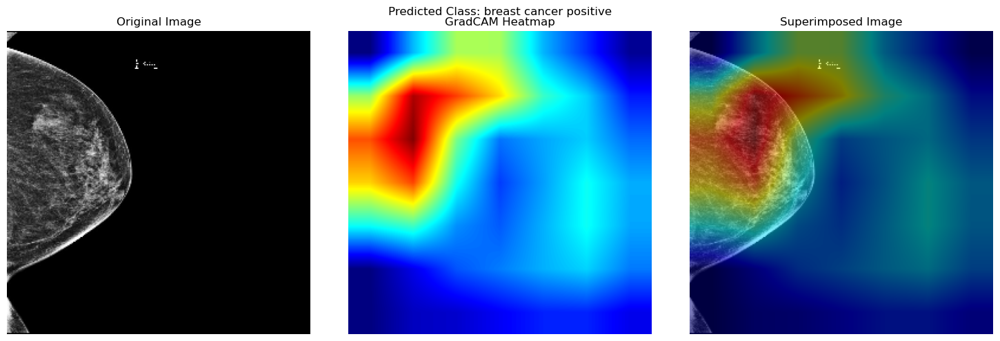

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


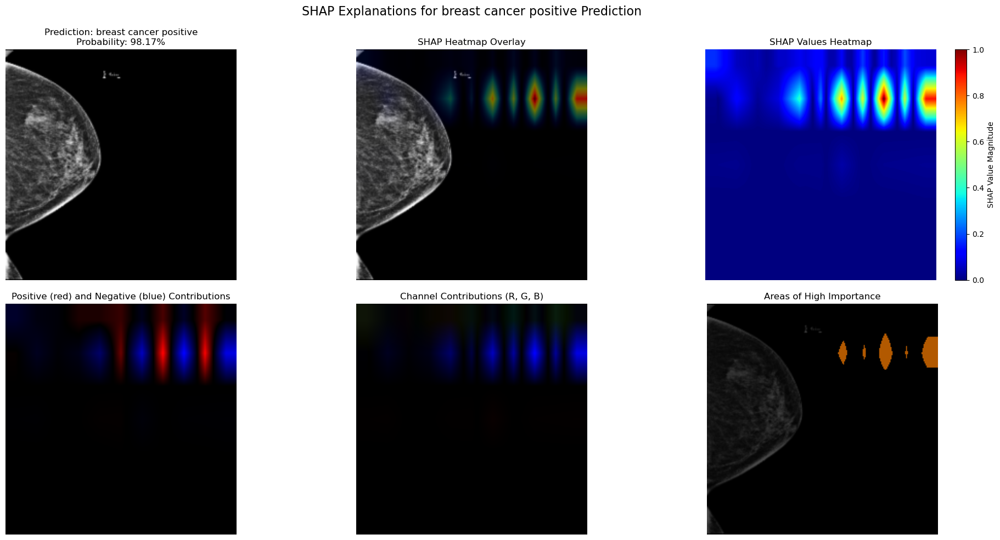

<Figure size 1000x600 with 0 Axes>

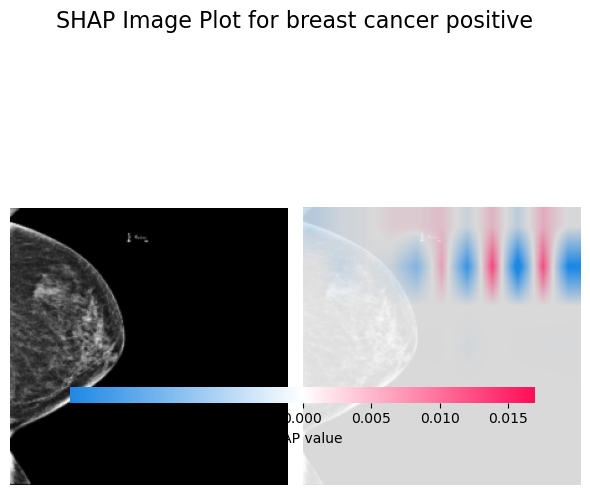


Diagnosis Results:
Classification: breast cancer positive
Confidence: 98.17%

Class Probabilities:
breast cancer negative: 1.82%
breast cancer positive: 98.17%

=== Comparing Explainability Methods for breast cancer positive.jpg ===
Predicted class: breast cancer positive (confidence: 98.17%)

Generating GradCAM...


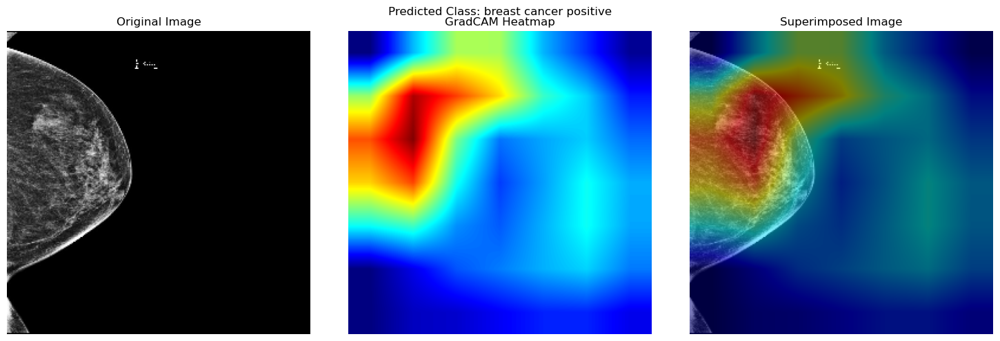

GradCAM generation time: 0.2123 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


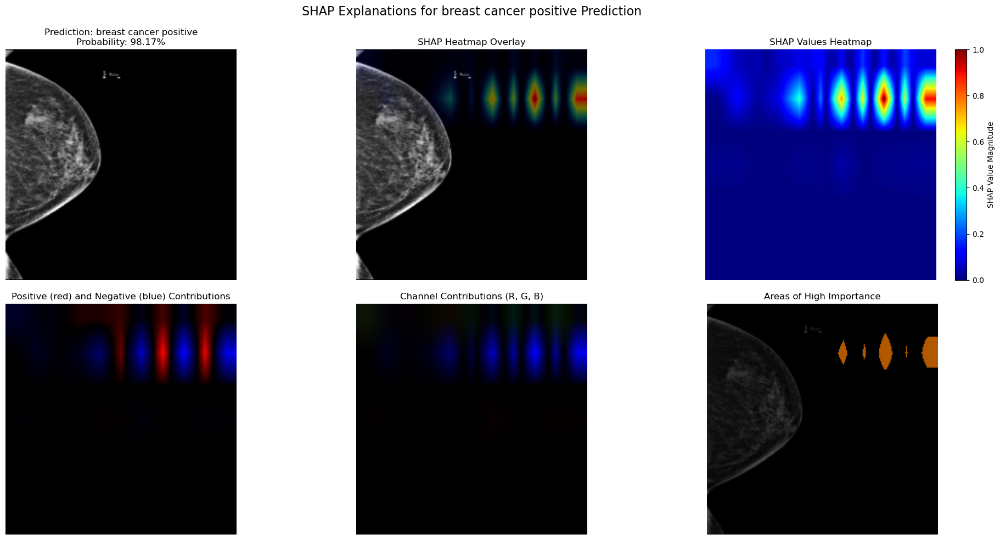

<Figure size 1000x600 with 0 Axes>

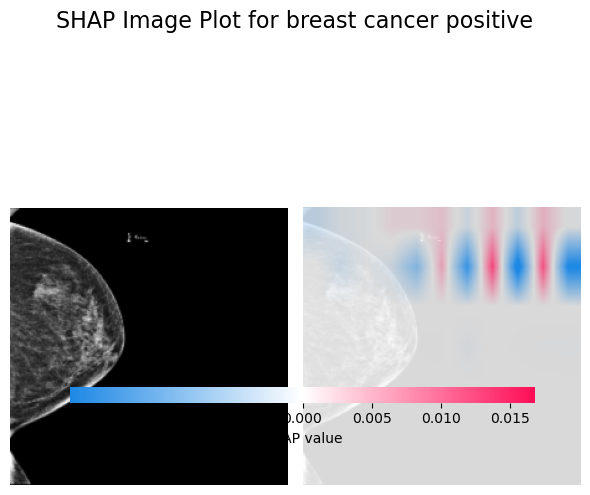

SHAP generation time: 66.2664 seconds


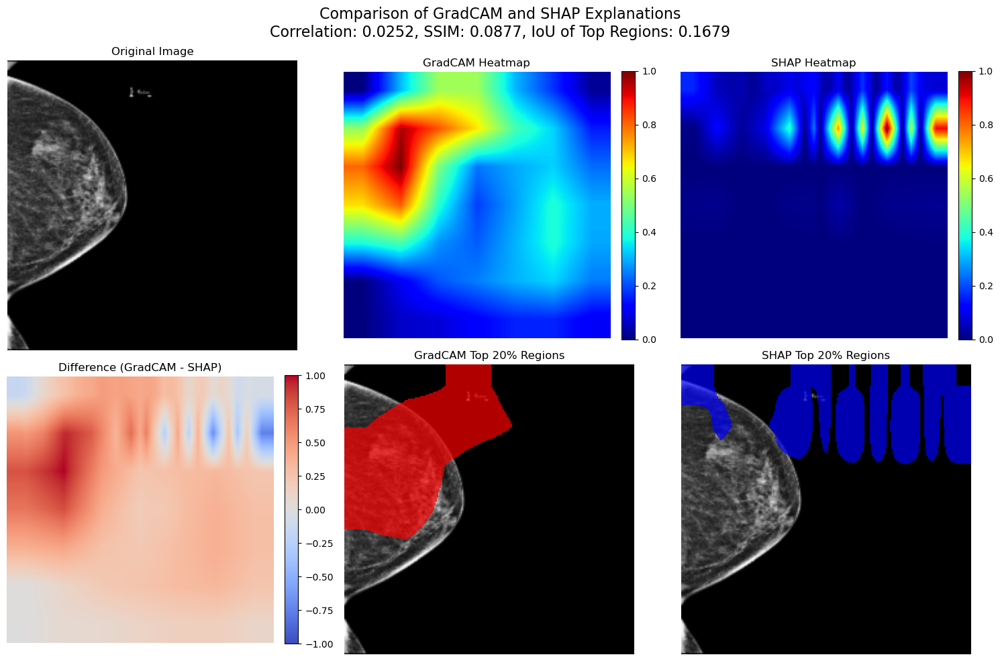


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.0252
SSIM between heatmaps: 0.0877
IoU of top 20% regions: 0.1679
GradCAM execution time: 0.2123 seconds
SHAP execution time: 66.2664 seconds

Diagnosis Results:
Classification: bone not fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 0.00%
bone not fractured: 100.00%


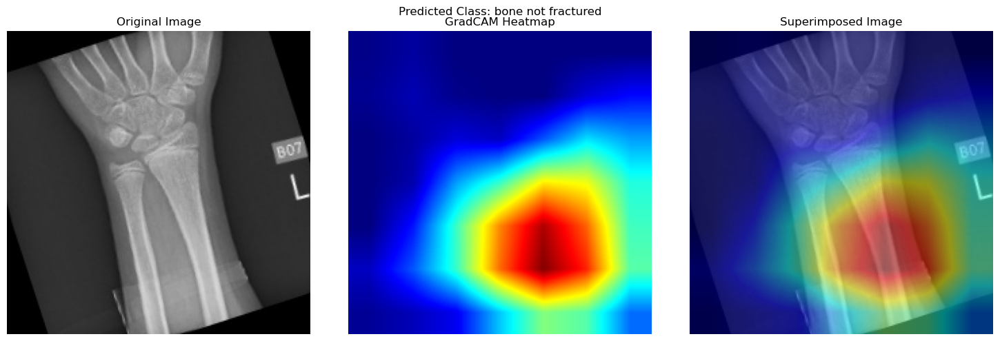

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


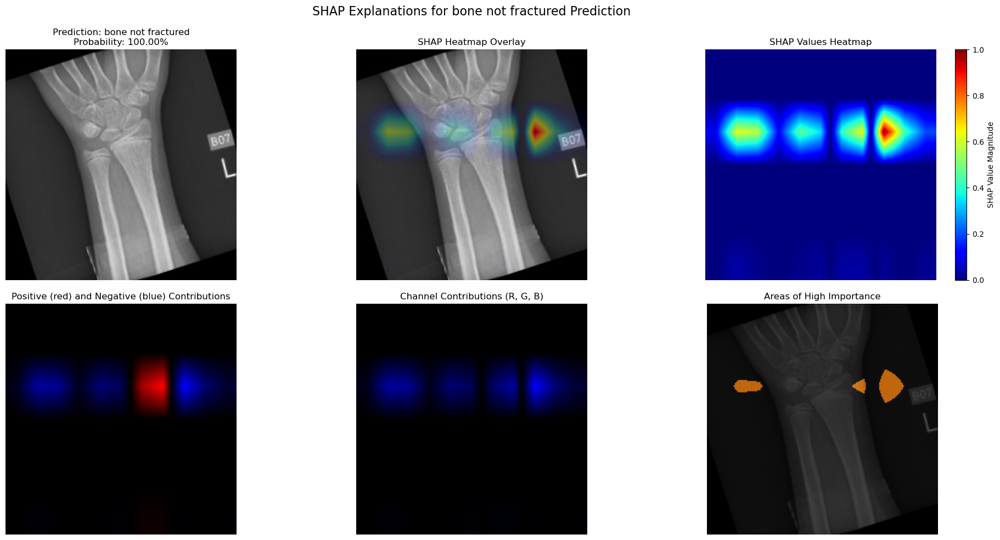

<Figure size 1000x600 with 0 Axes>

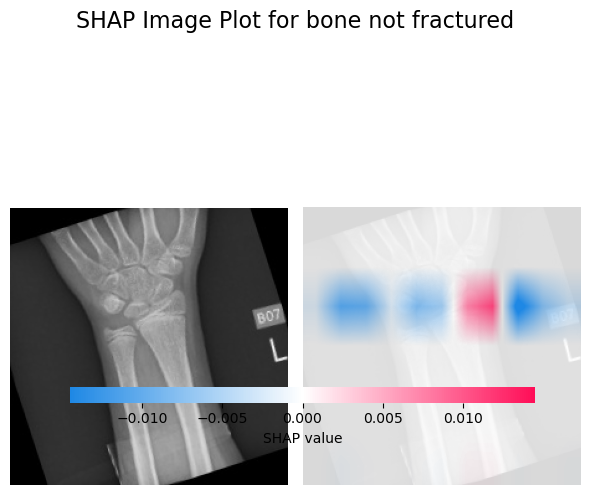


Diagnosis Results:
Classification: bone not fractured
Confidence: 100.00%

Class Probabilities:
bone fractured: 0.00%
bone not fractured: 100.00%

=== Comparing Explainability Methods for bone not fractured.jpg ===
Predicted class: bone not fractured (confidence: 100.00%)

Generating GradCAM...


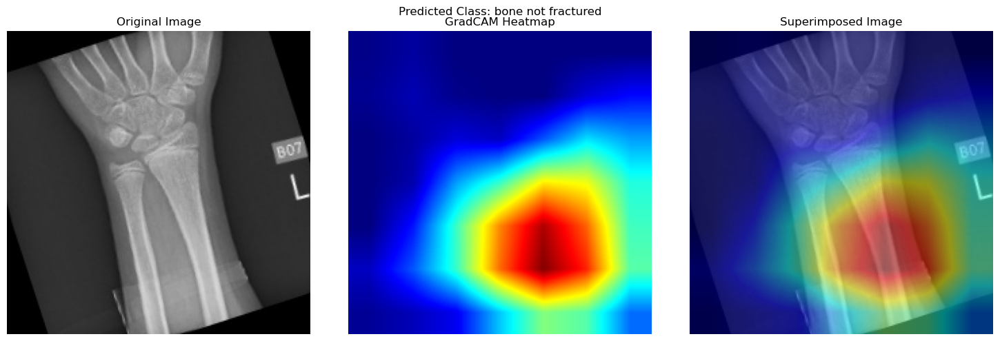

GradCAM generation time: 0.2232 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


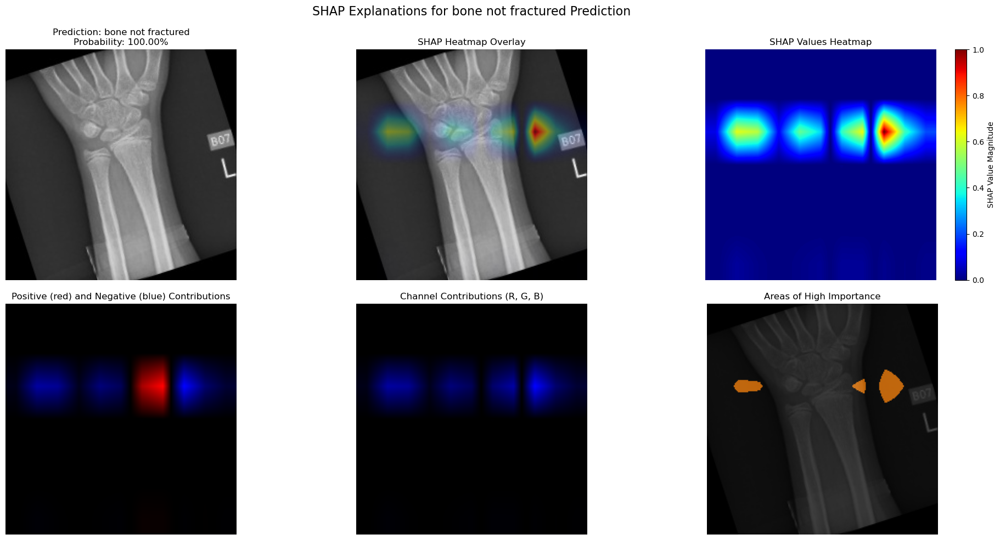

<Figure size 1000x600 with 0 Axes>

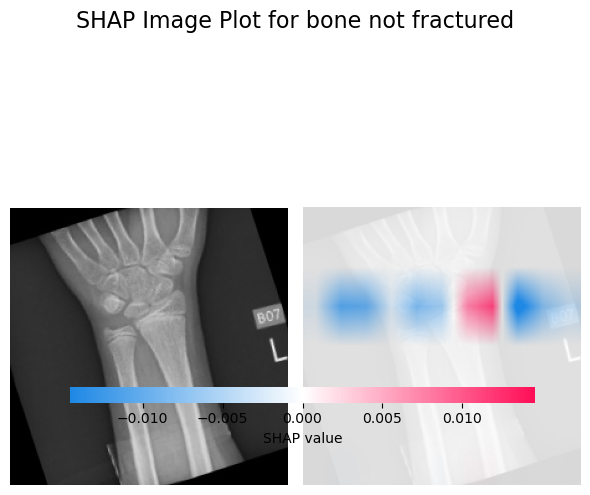

SHAP generation time: 65.7348 seconds


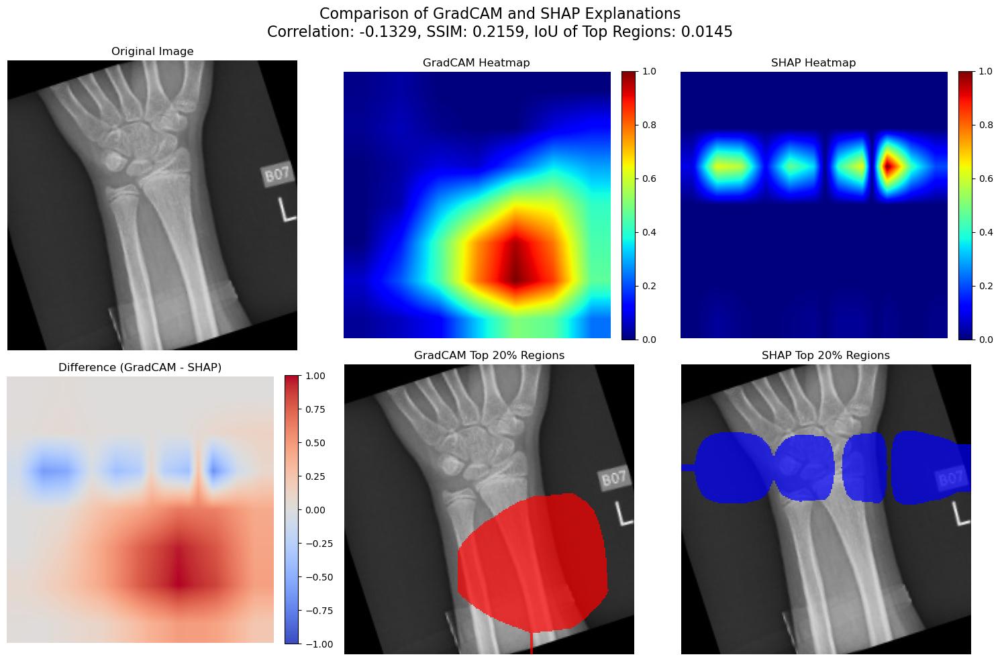


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.1329
SSIM between heatmaps: 0.2159
IoU of top 20% regions: 0.0145
GradCAM execution time: 0.2232 seconds
SHAP execution time: 65.7348 seconds

Diagnosis Results:
Classification: squamous cell carcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 0.00%
squamous cell carcinoma: 100.00%


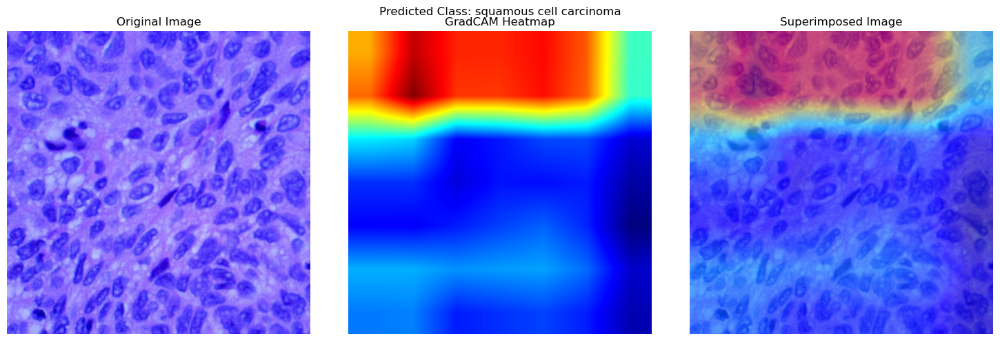

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


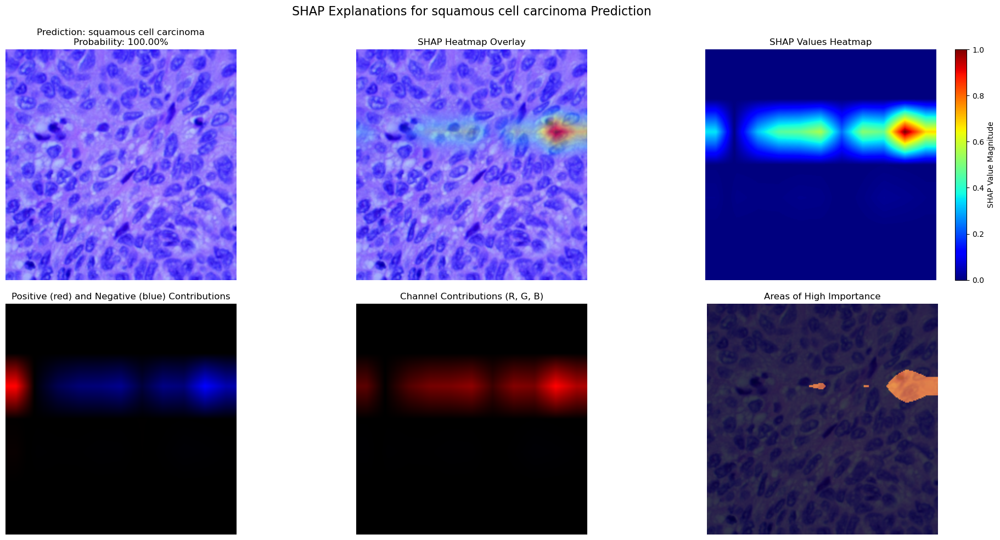

<Figure size 1000x600 with 0 Axes>

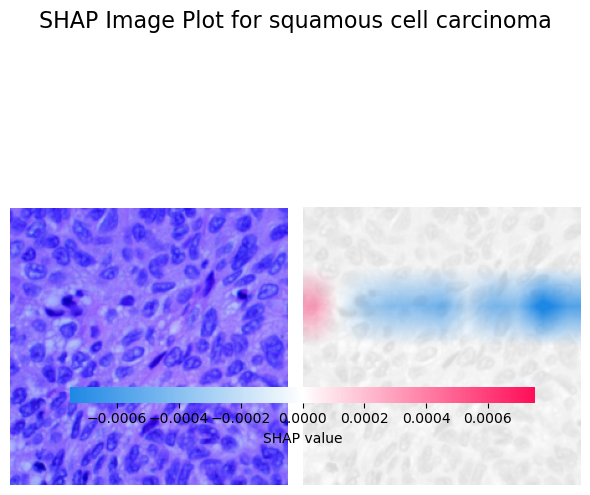


Diagnosis Results:
Classification: squamous cell carcinoma
Confidence: 100.00%

Class Probabilities:
adenocarcinoma: 0.00%
benign: 0.00%
squamous cell carcinoma: 100.00%

=== Comparing Explainability Methods for squamous cell carcinoma.jpg ===
Predicted class: squamous cell carcinoma (confidence: 100.00%)

Generating GradCAM...


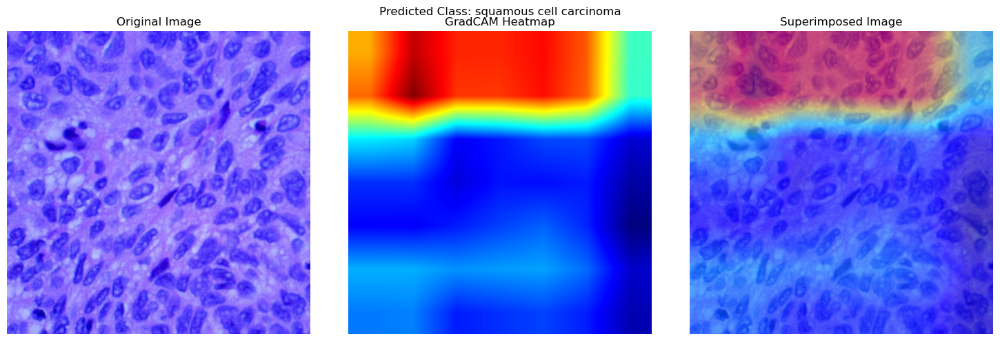

GradCAM generation time: 0.3574 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


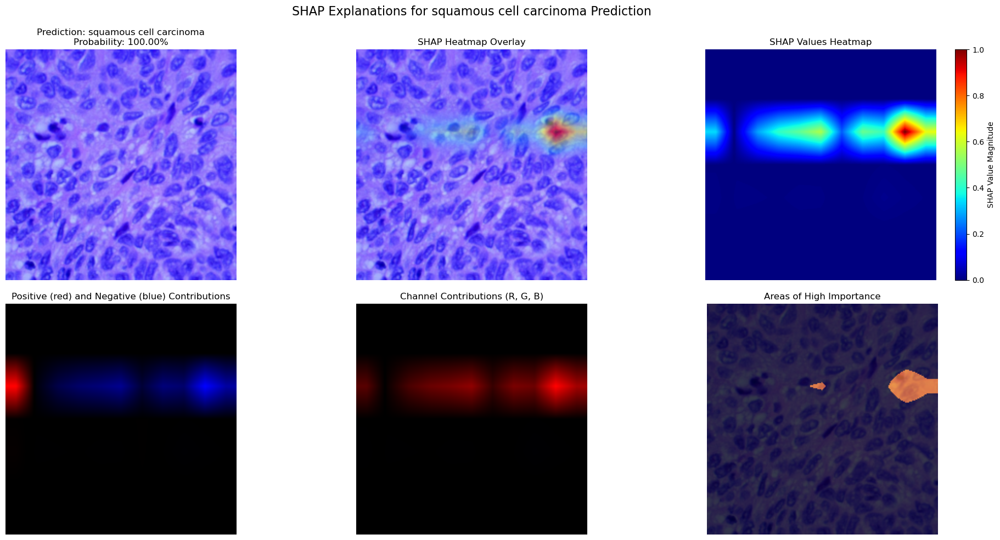

<Figure size 1000x600 with 0 Axes>

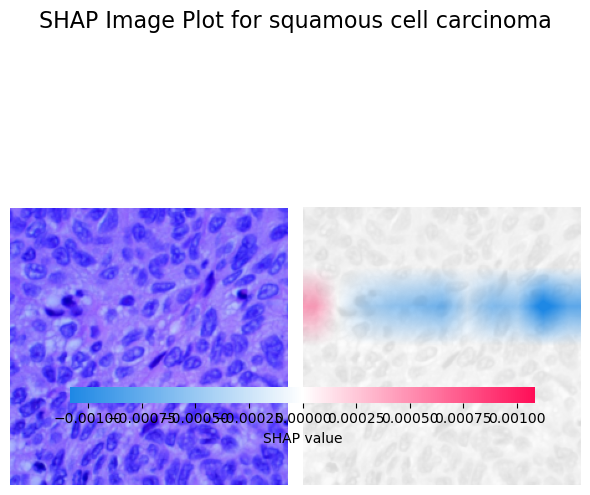

SHAP generation time: 65.4881 seconds


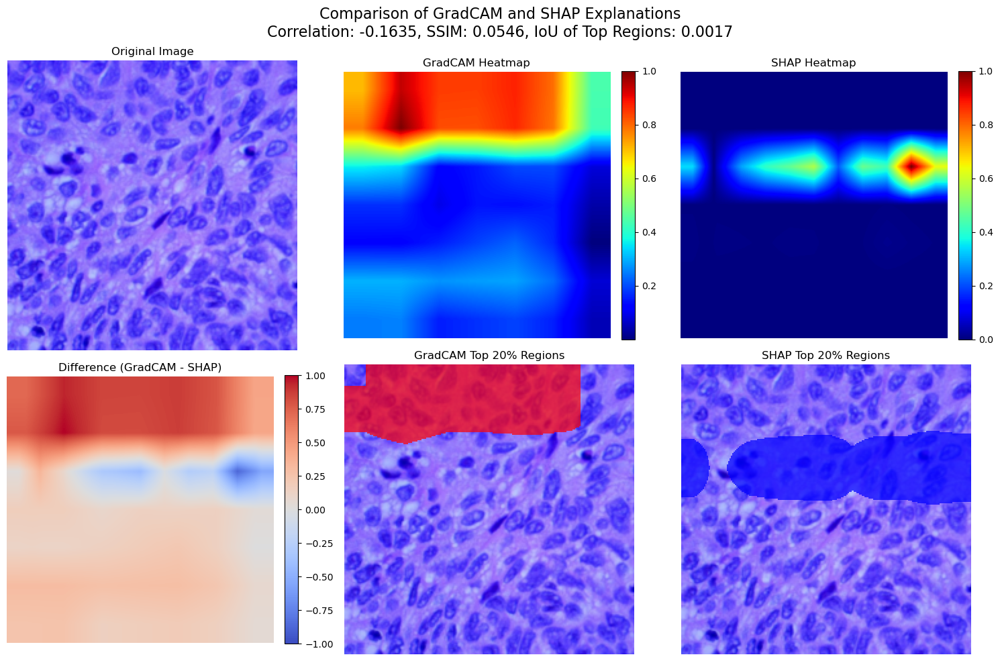


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.1635
SSIM between heatmaps: 0.0546
IoU of top 20% regions: 0.0017
GradCAM execution time: 0.3574 seconds
SHAP execution time: 65.4881 seconds

Diagnosis Results:
Classification: meningioma
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 100.00%


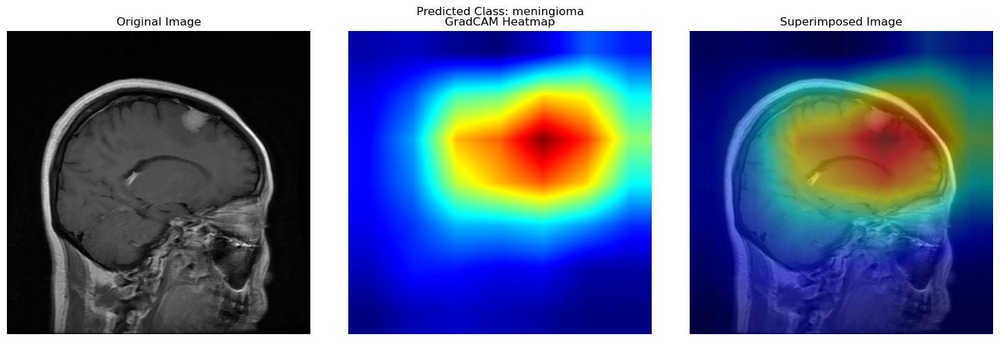

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


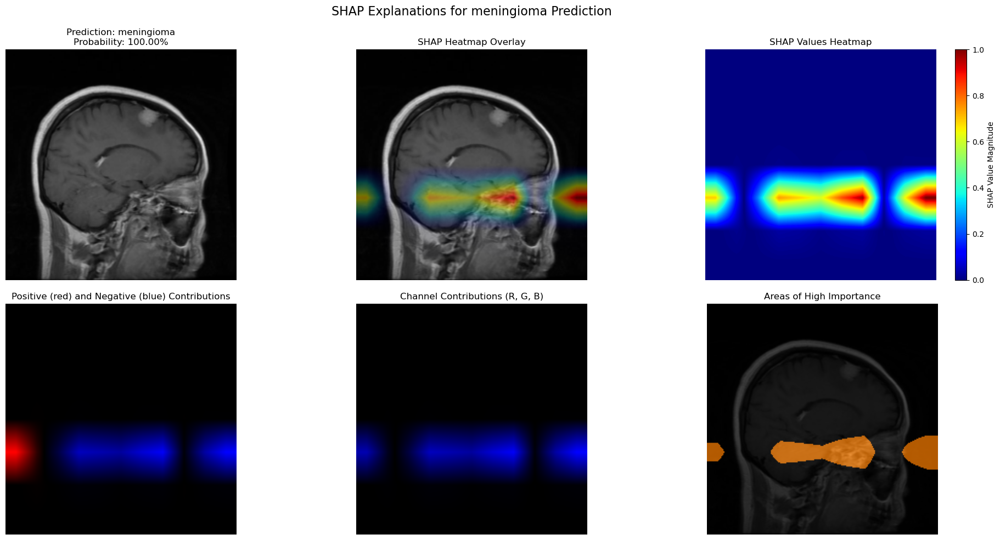

<Figure size 1000x600 with 0 Axes>

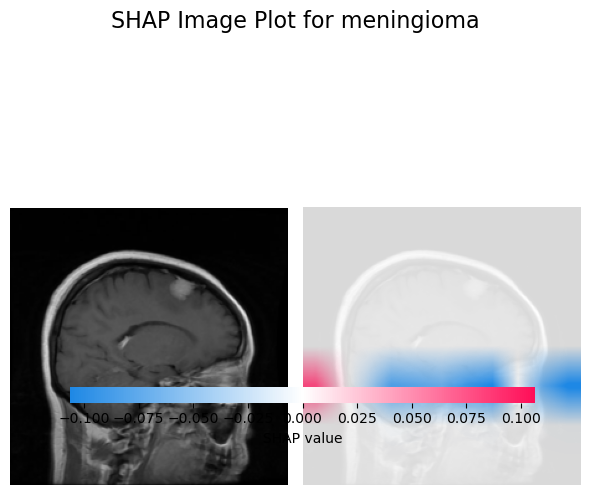


Diagnosis Results:
Classification: meningioma
Confidence: 100.00%

Class Probabilities:
pituitary: 0.00%
healthy brain: 0.00%
glioma: 0.00%
meningioma: 100.00%

=== Comparing Explainability Methods for meningioma.jpg ===
Predicted class: meningioma (confidence: 100.00%)

Generating GradCAM...


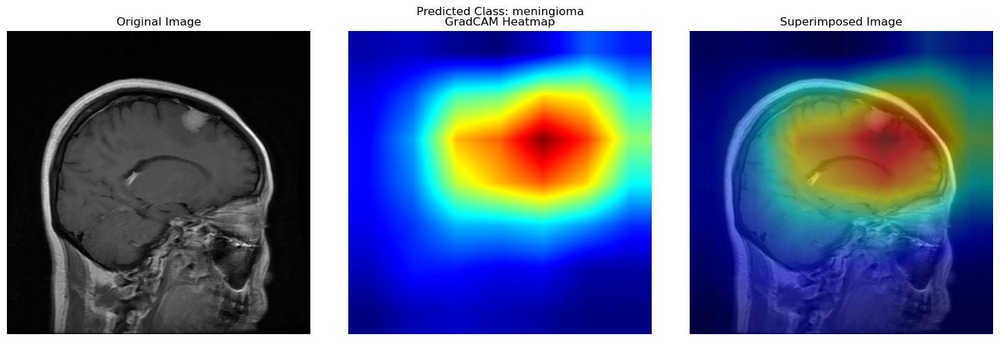

GradCAM generation time: 0.3768 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


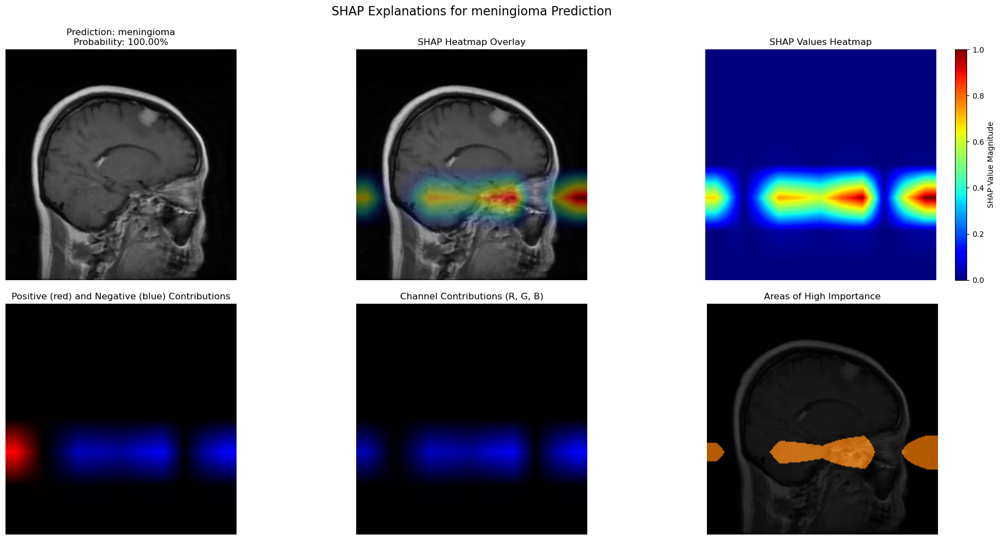

<Figure size 1000x600 with 0 Axes>

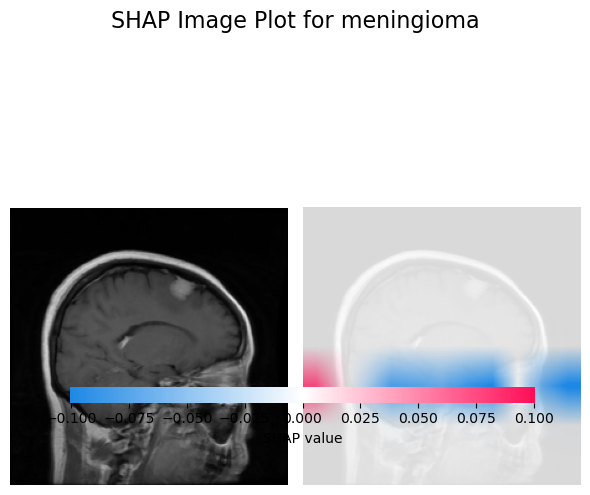

SHAP generation time: 64.9335 seconds


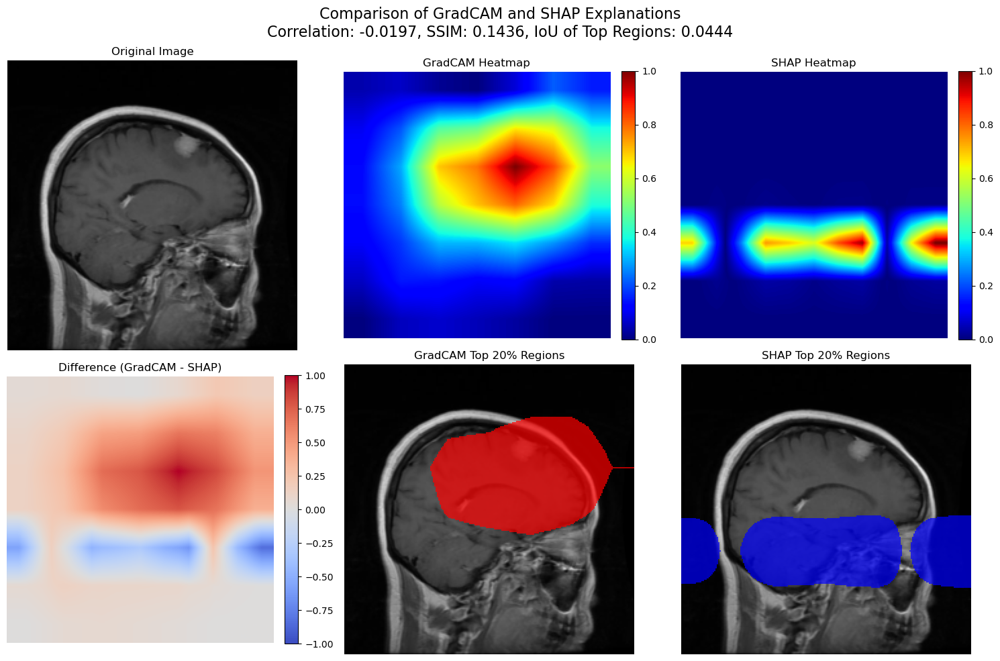


=== Explainability Methods Comparison ===
Correlation between heatmaps: -0.0197
SSIM between heatmaps: 0.1436
IoU of top 20% regions: 0.0444
GradCAM execution time: 0.3768 seconds
SHAP execution time: 64.9335 seconds

Diagnosis Results:
Classification: breast cancer negative
Confidence: 86.08%

Class Probabilities:
breast cancer negative: 86.08%
breast cancer positive: 13.92%


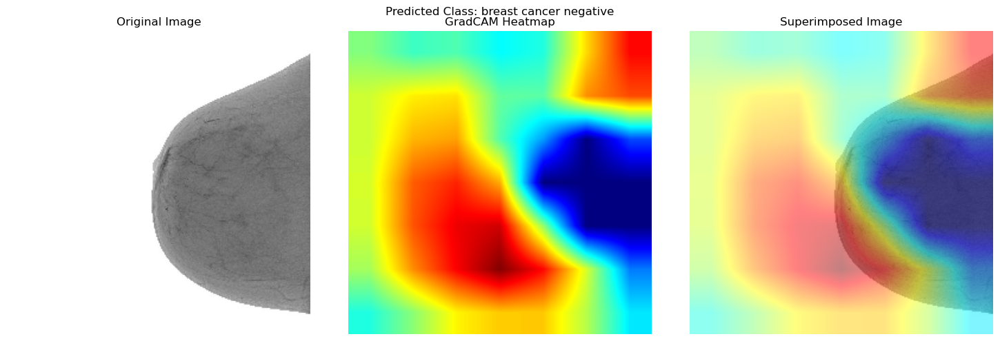

SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


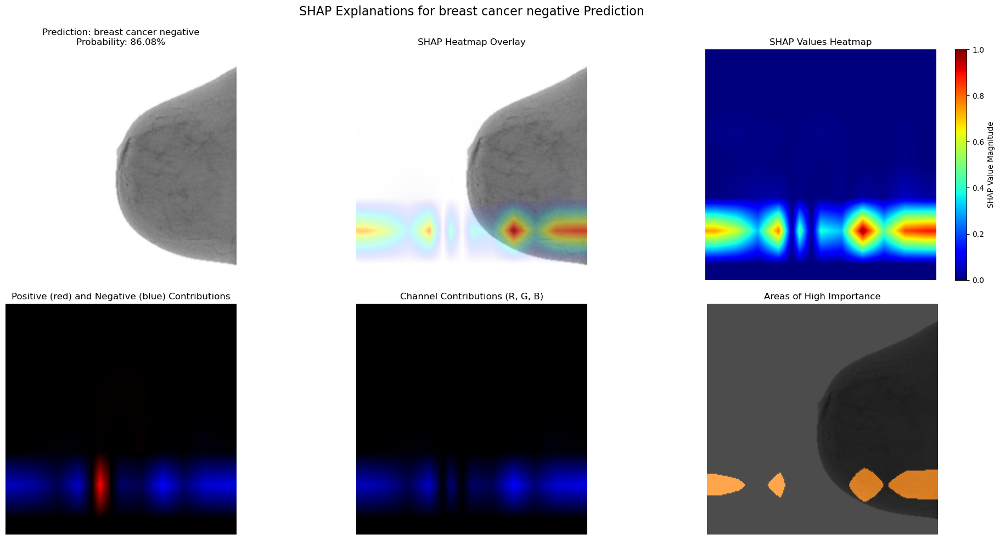

<Figure size 1000x600 with 0 Axes>

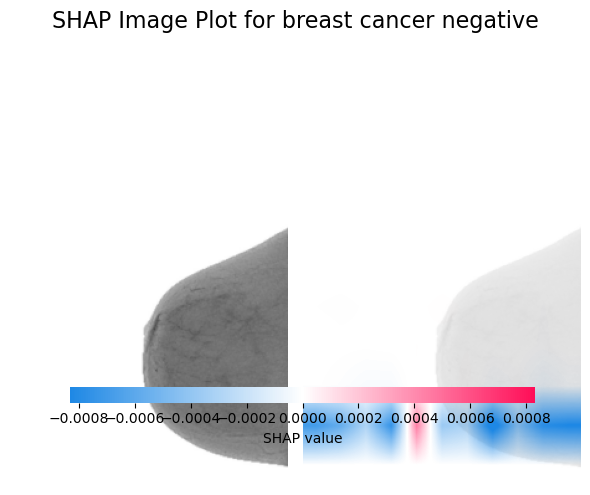


Diagnosis Results:
Classification: breast cancer negative
Confidence: 86.08%

Class Probabilities:
breast cancer negative: 86.08%
breast cancer positive: 13.92%

=== Comparing Explainability Methods for breast cancer negative.jpg ===
Predicted class: breast cancer negative (confidence: 86.08%)

Generating GradCAM...


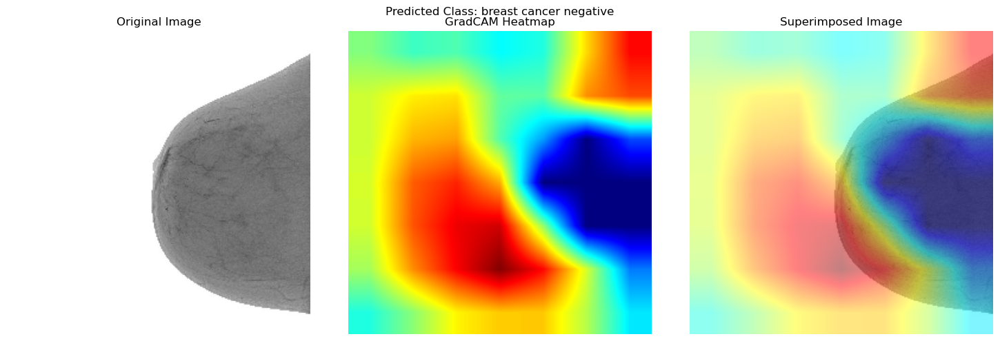

GradCAM generation time: 0.2039 seconds

Generating SHAP explanation...
SHAP values shape: (7, 7, 11)
Resizing SHAP values from (7, 7, 11) to match image dimensions


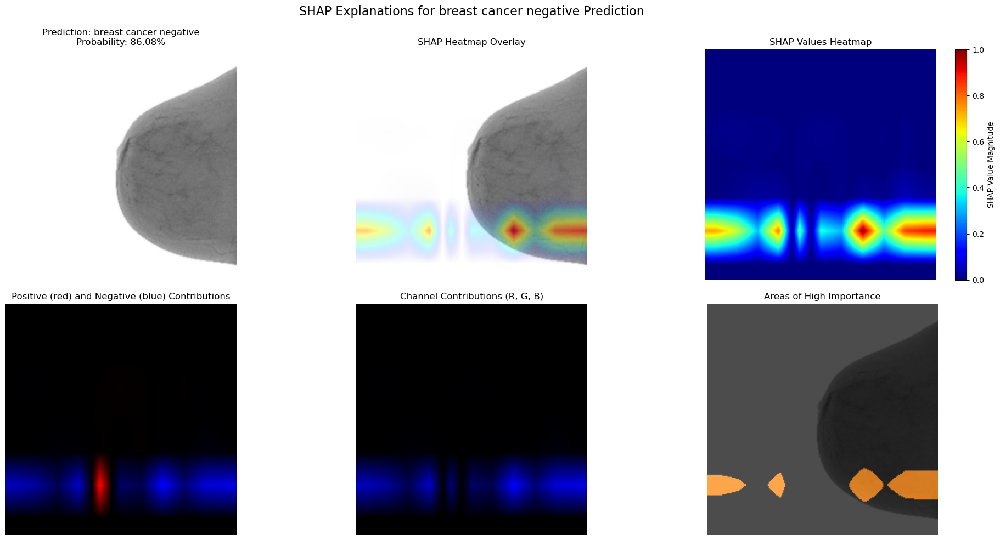

<Figure size 1000x600 with 0 Axes>

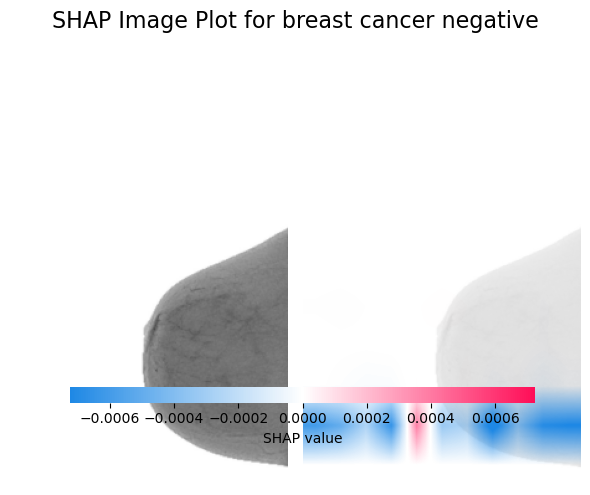

SHAP generation time: 64.7600 seconds


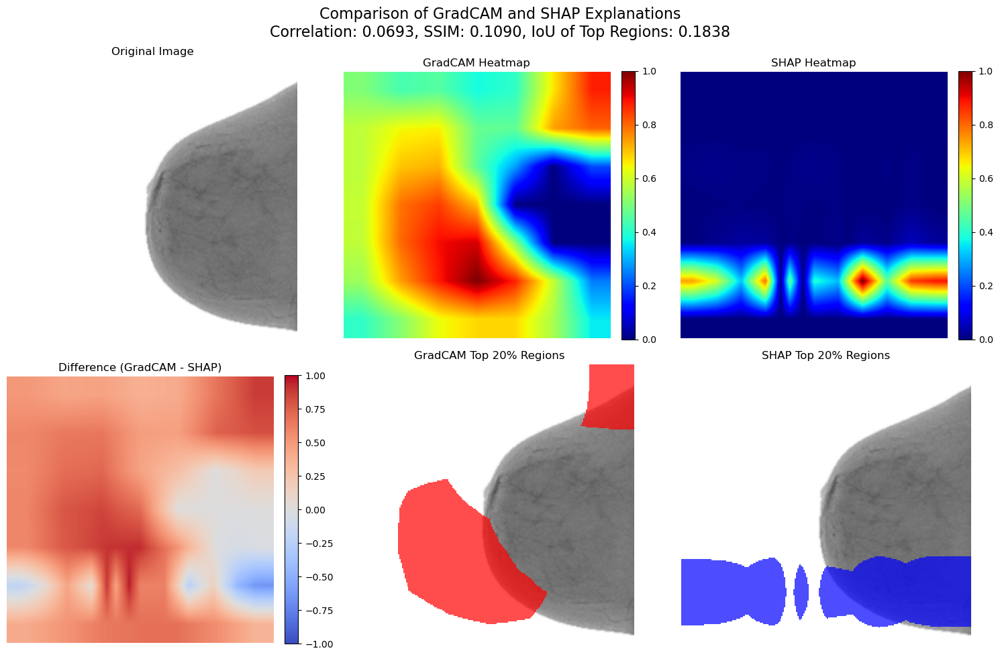


=== Explainability Methods Comparison ===
Correlation between heatmaps: 0.0693
SSIM between heatmaps: 0.1090
IoU of top 20% regions: 0.1838
GradCAM execution time: 0.2039 seconds
SHAP execution time: 64.7600 seconds

=== Evaluation Summary ===
Total images evaluated: 10
Average prediction confidence: 97.68%

GradCAM metrics:
  Average execution time: 0.24 seconds
  Average energy concentration: 0.4463

SHAP metrics:
  Average execution time: 81.85 seconds
  Average energy concentration: 0.8165

Comparison metrics:
  Average correlation: 0.2135
  Average SSIM: 0.2042
  Average IoU: 0.1912


,image_path,diagnosis_area,predicted_class,confidence,gradcam_time,gradcam_energy,shap_time,shap_energy,correlation,ssim,iou
0,/Users/academiccity/Documents/amokorankye/git ...,Brain Tumors,pituitary,1.000000,0.242207,0.475022,63.477410,0.937795,0.405386,0.246217,0.410103
1,/Users/academiccity/Documents/amokorankye/git ...,Bone Fractures,bone fractured,1.000000,0.196941,0.522336,62.069665,0.825612,0.374199,0.245111,0.282838
2,/Users/academiccity/Documents/amokorankye/git ...,Brain Tumors,healthy brain,1.000000,0.182840,0.490539,63.442192,0.599950,0.645739,0.392206,0.297350
3,/Users/academiccity/Documents/amokorankye/git ...,Lung Cancer,adenocarcinoma,1.000000,0.300803,0.313354,63.154750,0.588083,0.484229,0.290313,0.209765
4,/Users/academiccity/Documents/amokorankye/git ...,Brain Tumors,glioma,0.925251,0.188052,0.428331,62.200063,0.706067,0.446888,0.257610,0.299366
5,/Users/academiccity/Documents/amokorankye/git ...,Breast Cancer,breast cancer positive,0.981722,0.333098,0.414978,62.999498,0.850336,0.025172,0.087650,0.167938
6,/Users/academiccity/Documents/amokorankye/git ...,Bone Fractures,bone not fractured,0.999996,0.180447,0.539927,65.718628,0.907635,-0.132908,0.215885,0.014507
7,/Users/academiccity/Documents/amokorankye/git ...,Lung Cancer,squamous cell carcinoma,0.999999,0.278373,0.473508,64.062084,0.918553,-0.163453,0.054590,0.001666
8,/Users/academiccity/Documents/amokorankye/git ...,Brain Tumors,meningioma,1.000000,0.219114,0.493490,247.325747,0.927119,-0.019744,0.143609,0.044388
9,/Users/academiccity/Documents/amokorankye/git ...,Breast Cancer,breast cancer negative,0.860776,0.245290,0.311080,64.075440,0.903794,0.069330,0.108987,0.183791


In [61]:
from tqdm.notebook import tqdm
import pandas as pd

# Systematic evaluation of test images using both prediction and explainability methods

# Define which evaluation methods to use
run_prediction = True
run_gradcam = True
run_shap = True  # SHAP is computationally intensive, so we can toggle it
run_comparison = True  # Compare GradCAM and SHAP

# Set sample size for SHAP (smaller is faster but less accurate)
shap_sample_size = 50

# Store results
results = []

# Process test images with progress bar
for image_path in tqdm(test_images, desc="Evaluating images"):
    # Determine diagnosis area from the image path or filename
    filename = os.path.basename(image_path).lower()
    
    if any(x in filename for x in ['glioma', 'meningioma', 'pituitary', 'healthy brain']):
        diagnosisArea = "Brain Tumors"
    elif any(x in filename for x in ['breast']):
        diagnosisArea = "Breast Cancer"
    elif any(x in filename for x in ['bone', 'fracture']):
        diagnosisArea = "Bone Fractures"
    elif any(x in filename for x in ['adenocarcinoma', 'squamous', 'benign']):
        diagnosisArea = "Lung Cancer"
    else:
        diagnosisArea = None
    
    result = {"image_path": image_path, "diagnosis_area": diagnosisArea}
    
    # Run prediction
    if run_prediction:
        pred = predict(image_path, diagnosisArea)
        if pred:
            result.update({
                "predicted_class": pred['diagnosis'],
                "confidence": pred['confidence']
            })
    
    # Run GradCAM evaluation
    if run_gradcam:
        try:
            start_time = time.time()
            cam = apply_gradcam(image_path, comprehensive_model, comprehensive_model.layer4[-1])
            gradcam_time = time.time() - start_time
            
            if cam is not None:
                # Calculate energy concentration
                cam_sorted = np.sort(cam.flatten())[::-1]
                energy_concentration = np.sum(cam_sorted[:int(0.2*len(cam_sorted))]) / np.sum(cam_sorted)
                
                result.update({
                    "gradcam_time": gradcam_time,
                    "gradcam_energy": energy_concentration
                })
        except Exception as e:
            print(f"GradCAM error for {filename}: {str(e)}")
    
    # Run SHAP evaluation (on a subset due to computational cost)
    if run_shap:
        try:
            # Get target class from prediction
            target_class = classes.index(result["predicted_class"]) if "predicted_class" in result else None
            
            start_time = time.time()
            shap_values, _ = apply_shap(image_path, comprehensive_model, target_class, n_samples=shap_sample_size)
            shap_time = time.time() - start_time
            
            if shap_values is not None:
                # Aggregate SHAP values
                shap_magnitude = np.sum(np.abs(shap_values), axis=0)
                
                # Calculate metrics
                shap_sorted = np.sort(shap_magnitude.flatten())[::-1]
                energy_concentration = np.sum(shap_sorted[:int(0.2*len(shap_sorted))]) / np.sum(shap_sorted)
                
                result.update({
                    "shap_time": shap_time,
                    "shap_energy": energy_concentration
                })
        except Exception as e:
            print(f"SHAP error for {filename}: {str(e)}")
    
    # Compare GradCAM and SHAP if both were successful
    if run_comparison and "gradcam_time" in result and "shap_time" in result:
        try:
            comparison = compare_explainability_methods(image_path, diagnosisArea)
            if comparison:
                result.update({
                    "correlation": comparison["correlation"],
                    "ssim": comparison["ssim"],
                    "iou": comparison["iou"]
                })
        except Exception as e:
            print(f"Comparison error for {filename}: {str(e)}")
    
    # Add result to collection
    results.append(result)

# Convert results to dataframe for easier analysis
results_df = pd.DataFrame(results)

# Display summary statistics
print("\n=== Evaluation Summary ===")
print(f"Total images evaluated: {len(results_df)}")
print(f"Average prediction confidence: {results_df['confidence'].mean():.2%}")

if 'gradcam_time' in results_df.columns:
    print(f"\nGradCAM metrics:")
    print(f"  Average execution time: {results_df['gradcam_time'].mean():.2f} seconds")
    print(f"  Average energy concentration: {results_df['gradcam_energy'].mean():.4f}")

if 'shap_time' in results_df.columns:
    print(f"\nSHAP metrics:")
    print(f"  Average execution time: {results_df['shap_time'].mean():.2f} seconds")
    print(f"  Average energy concentration: {results_df['shap_energy'].mean():.4f}")

if 'correlation' in results_df.columns:
    print(f"\nComparison metrics:")
    print(f"  Average correlation: {results_df['correlation'].mean():.4f}")
    print(f"  Average SSIM: {results_df['ssim'].mean():.4f}")
    print(f"  Average IoU: {results_df['iou'].mean():.4f}")

# Display the dataframe
results_df